In [28]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import os

In [29]:
!pip install torch torchvision # We need a new versino of torchvision for this project

In [30]:
import torch
import torchvision
from torchvision import datasets, models
from torchvision.transforms import functional as FT
from torchvision import transforms as T
from torch import nn, optim
from torch.nn import functional as F
from torch.utils.data import DataLoader, sampler, random_split, Dataset
import copy
import math
from PIL import Image
import cv2
import albumentations as A  # our data augmentation library

import matplotlib.pyplot as plt
%matplotlib inline

In [31]:
# remove arnings (optional)
import warnings
warnings.filterwarnings("ignore")
from collections import defaultdict, deque
import datetime
import time
from tqdm import tqdm # progress bar
from torchvision.utils import draw_bounding_boxes

In [32]:
print(torch.__version__)
print(torchvision.__version__)

2.1.2
0.16.2


In [33]:
!pip install pycocotools
from pycocotools.coco import COCO

In [34]:
from albumentations.pytorch import ToTensorV2

In [35]:
def get_transforms(train=False):
    if train:
        transform = A.Compose([
            A.Resize(600, 600), # our input size can be 600px
            A.HorizontalFlip(p=0.3),
            A.VerticalFlip(p=0.3),
            A.RandomBrightnessContrast(p=0.1),
            A.ColorJitter(p=0.1),
            ToTensorV2()
        ], bbox_params=A.BboxParams(format='coco'))
    else:
        transform = A.Compose([
            A.Resize(600, 600), # our input size can be 600px
            ToTensorV2()
        ], bbox_params=A.BboxParams(format='coco'))
    return transform

In [36]:
class AircraftDetection(datasets.VisionDataset):
    def __init__(self, root, split='train', transform=None, target_transform=None, transforms=None):
        # the 3 transform parameters are reuqired for datasets.VisionDataset
        super().__init__(root, transforms, transform, target_transform)
        self.split = split #train, valid, test
        self.coco = COCO(os.path.join(root, split, "_annotations.coco.json")) # annotatiosn stored here
        self.ids = list(sorted(self.coco.imgs.keys()))
        self.ids = [id for id in self.ids if (len(self._load_target(id)) > 0)]

    def _load_image(self, id: int):
        path = self.coco.loadImgs(id)[0]['file_name']
        image = cv2.imread(os.path.join(self.root, self.split, path))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        return image
    def _load_target(self, id):
        return self.coco.loadAnns(self.coco.getAnnIds(id))

    def __getitem__(self, index):
        id = self.ids[index]
        image = self._load_image(id)
        target = self._load_target(id)
        target = copy.deepcopy(self._load_target(id))

        boxes = [t['bbox'] + [t['category_id']] for t in target] # required annotation format for albumentations
        if self.transforms is not None:
            transformed = self.transforms(image=image, bboxes=boxes)

        image = transformed['image']
        boxes = transformed['bboxes']

        new_boxes = [] # convert from xywh to xyxy
        for box in boxes:
            xmin = box[0]
            xmax = xmin + box[2]
            ymin = box[1]
            ymax = ymin + box[3]
            new_boxes.append([xmin, ymin, xmax, ymax])

        boxes = torch.tensor(new_boxes, dtype=torch.float32)

        targ = {} # here is our transformed target
        targ['boxes'] = boxes
        targ['labels'] = torch.tensor([t['category_id'] for t in target], dtype=torch.int64)
        targ['image_id'] = torch.tensor([t['image_id'] for t in target])
        targ['area'] = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0]) # we have a different area
        targ['iscrowd'] = torch.tensor([t['iscrowd'] for t in target], dtype=torch.int64)
        return image.div(255), targ # scale images
    def __len__(self):
        return len(self.ids)

In [37]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="TGugCBUfodLpm3YJcfDR")
project = rf.workspace("aiden-lee-roboflow").project("aircraft-detection-thesis")
dataset = project.version(4).download("coco")

loading Roboflow workspace...
loading Roboflow project...


In [38]:
dataset_path = "/kaggle/working/Aircraft-Detection-Thesis-4"

In [39]:
coco = COCO(os.path.join(dataset_path, "train", "_annotations.coco.json"))
categories = coco.cats
n_classes = len(categories.keys())
categories

loading annotations into memory...
Done (t=0.06s)
creating index...
index created!


{0: {'id': 0, 'name': 'Aircraft', 'supercategory': 'none'},
 1: {'id': 1, 'name': 'A-10 Thunderbolt', 'supercategory': 'Aircraft'},
 2: {'id': 2, 'name': 'ATR 72', 'supercategory': 'Aircraft'},
 3: {'id': 3, 'name': 'Airbus A320 Family', 'supercategory': 'Aircraft'},
 4: {'id': 4, 'name': 'Boeing 737', 'supercategory': 'Aircraft'},
 5: {'id': 5, 'name': 'Boeing 747', 'supercategory': 'Aircraft'},
 6: {'id': 6,
  'name': 'General Dynamics F-16 Fighting Falcon',
  'supercategory': 'Aircraft'},
 7: {'id': 7,
  'name': 'Lockheed Martin F-35 Lightning II',
  'supercategory': 'Aircraft'},
 8: {'id': 8, 'name': 'Lufthansa', 'supercategory': 'Aircraft'},
 9: {'id': 9, 'name': 'Military', 'supercategory': 'Aircraft'},
 10: {'id': 10,
  'name': 'Northrop Grumman B-2 Spirit',
  'supercategory': 'Aircraft'},
 11: {'id': 11, 'name': 'Other Airlines', 'supercategory': 'Aircraft'},
 12: {'id': 12, 'name': 'Ryanair', 'supercategory': 'Aircraft'}}

In [40]:
classes = [i[1]['name'] for i in categories.items()]
classes

['Aircraft',
 'A-10 Thunderbolt',
 'ATR 72',
 'Airbus A320 Family',
 'Boeing 737',
 'Boeing 747',
 'General Dynamics F-16 Fighting Falcon',
 'Lockheed Martin F-35 Lightning II',
 'Lufthansa',
 'Military',
 'Northrop Grumman B-2 Spirit',
 'Other Airlines',
 'Ryanair']

In [41]:
train_dataset = AircraftDetection(root=dataset_path, transforms=get_transforms(True))

loading annotations into memory...
Done (t=0.29s)
creating index...
index created!


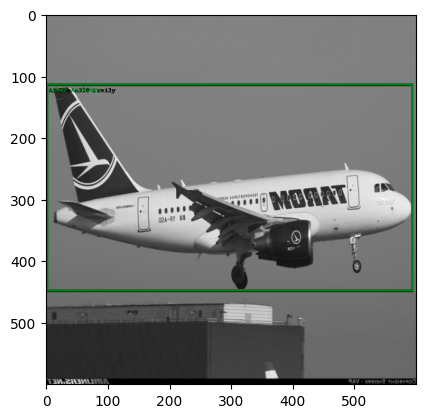

In [42]:
sample = train_dataset[2]
img_int = torch.tensor(sample[0] * 255, dtype=torch.uint8)
plt.imshow(draw_bounding_boxes(
    img_int, sample[1]['boxes'], [classes[i] for i in sample[1]['labels']], width=4
).permute(1, 2, 0))

In [43]:
len(train_dataset)

5442

In [44]:
#torchvision.models.detection.fasterrcnn_resnet50(pretrained = True)
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained = True)
in_features = model.roi_heads.box_predictor.cls_score.in_features # we need to change the head
model.roi_heads.box_predictor = models.detection.faster_rcnn.FastRCNNPredictor(in_features, n_classes)

In [45]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [46]:
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=collate_fn)

In [47]:
images,targets = next(iter(train_loader))
images = list(image for image in images)
targets = [{k:v for k, v in t.items()} for t in targets]
output = model(images, targets)

In [48]:
if torch.cuda.is_available():
    # Set device to CUDA
    device = torch.device("cuda")
    print("CUDA is available. Using GPU.")
else:
    # If CUDA is not available, fall back to CPU
    device = torch.device("cpu")
    print("CUDA is not available. Using CPU.")

CUDA is available. Using GPU.


In [49]:
model = model.to(device)

In [50]:
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.01, momentum=0.9, nesterov=True, weight_decay=1e-4)

In [51]:
import sys

## Training

In [52]:
def train_one_epoch(model, optimizer, loader, device, epoch):
    model.to(device)
    model.train()

#     lr_scheduler = None
#     if epoch == 0:
#         warmup_factor = 1.0 / 1000 # do lr warmup
#         warmup_iters = min(1000, len(loader) - 1)

#         lr_scheduler = optim.lr_scheduler.LinearLR(optimizer, start_factor = warmup_factor, total_iters=warmup_iters)

    all_losses = []
    all_losses_dict = []

    for images, targets in tqdm(loader):
        images = list(image.to(device) for image in images)
        targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets) # the model computes the loss automatically if we pass in targets
        losses = sum(loss for loss in loss_dict.values())
        loss_dict_append = {k: v.item() for k, v in loss_dict.items()}
        loss_value = losses.item()

        all_losses.append(loss_value)
        all_losses_dict.append(loss_dict_append)

        if not math.isfinite(loss_value):
            print(f"Loss is {loss_value}, stopping trainig") # train if loss becomes infinity
            print(loss_dict)
            #sys.exit(1)

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

#         if lr_scheduler is not None:
#             lr_scheduler.step() #

    all_losses_dict = pd.DataFrame(all_losses_dict) # for printing
    print("Epoch {}, lr: {:.6f}, loss: {:.6f}, loss_classifier: {:.6f}, loss_box: {:.6f}, loss_rpn_box: {:.6f}, loss_object: {:.6f}".format(
        epoch, optimizer.param_groups[0]['lr'], np.mean(all_losses),
        all_losses_dict['loss_classifier'].mean(),
        all_losses_dict['loss_box_reg'].mean(),
        all_losses_dict['loss_rpn_box_reg'].mean(),
        all_losses_dict['loss_objectness'].mean()
    ))
    
    return np.mean(all_losses)

In [53]:
val_dataset = AircraftDetection(root=dataset_path, split="valid", transforms=get_transforms(False))
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, num_workers=4, collate_fn=collate_fn)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


In [54]:
from typing import Tuple, List, Dict, Optional
import torch
from torch import Tensor
from collections import OrderedDict
from torchvision.models.detection.roi_heads import fastrcnn_loss
from torchvision.models.detection.rpn import concat_box_prediction_layers
def eval_forward(model, images, targets):
    # type: (List[Tensor], Optional[List[Dict[str, Tensor]]]) -> Tuple[Dict[str, Tensor], List[Dict[str, Tensor]]]
    """
    Args:
        images (list[Tensor]): images to be processed
        targets (list[Dict[str, Tensor]]): ground-truth boxes present in the image (optional)
    Returns:
        result (list[BoxList] or dict[Tensor]): the output from the model.
            It returns list[BoxList] contains additional fields
            like `scores`, `labels` and `mask` (for Mask R-CNN models).
    """
    model.eval()

    original_image_sizes: List[Tuple[int, int]] = []
    for img in images:
        val = img.shape[-2:]
        assert len(val) == 2
        original_image_sizes.append((val[0], val[1]))

    images, targets = model.transform(images, targets)

    # Check for degenerate boxes
    # TODO: Move this to a function
    if targets is not None:
        for target_idx, target in enumerate(targets):
            boxes = target["boxes"]
            degenerate_boxes = boxes[:, 2:] <= boxes[:, :2]
            if degenerate_boxes.any():
                # print the first degenerate box
                bb_idx = torch.where(degenerate_boxes.any(dim=1))[0][0]
                degen_bb: List[float] = boxes[bb_idx].tolist()
                raise ValueError(
                    "All bounding boxes should have positive height and width."
                    f" Found invalid box {degen_bb} for target at index {target_idx}."
                )

    features = model.backbone(images.tensors)
    if isinstance(features, torch.Tensor):
        features = OrderedDict([("0", features)])
    model.rpn.training=True
    #model.roi_heads.training=True


    #####proposals, proposal_losses = model.rpn(images, features, targets)
    features_rpn = list(features.values())
    objectness, pred_bbox_deltas = model.rpn.head(features_rpn)
    anchors = model.rpn.anchor_generator(images, features_rpn)

    num_images = len(anchors)
    num_anchors_per_level_shape_tensors = [o[0].shape for o in objectness]
    num_anchors_per_level = [s[0] * s[1] * s[2] for s in num_anchors_per_level_shape_tensors]
    objectness, pred_bbox_deltas = concat_box_prediction_layers(objectness, pred_bbox_deltas)
    # apply pred_bbox_deltas to anchors to obtain the decoded proposals
    # note that we detach the deltas because Faster R-CNN do not backprop through
    # the proposals
    proposals = model.rpn.box_coder.decode(pred_bbox_deltas.detach(), anchors)
    proposals = proposals.view(num_images, -1, 4)
    proposals, scores = model.rpn.filter_proposals(proposals, objectness, images.image_sizes, num_anchors_per_level)

    proposal_losses = {}
    assert targets is not None
    labels, matched_gt_boxes = model.rpn.assign_targets_to_anchors(anchors, targets)
    regression_targets = model.rpn.box_coder.encode(matched_gt_boxes, anchors)
    loss_objectness, loss_rpn_box_reg = model.rpn.compute_loss(
        objectness, pred_bbox_deltas, labels, regression_targets
    )
    proposal_losses = {
        "loss_objectness": loss_objectness,
        "loss_rpn_box_reg": loss_rpn_box_reg,
    }

    #####detections, detector_losses = model.roi_heads(features, proposals, images.image_sizes, targets)
    image_shapes = images.image_sizes
    proposals, matched_idxs, labels, regression_targets = model.roi_heads.select_training_samples(proposals, targets)
    box_features = model.roi_heads.box_roi_pool(features, proposals, image_shapes)
    box_features = model.roi_heads.box_head(box_features)
    class_logits, box_regression = model.roi_heads.box_predictor(box_features)

    result: List[Dict[str, torch.Tensor]] = []
    detector_losses = {}
    loss_classifier, loss_box_reg = fastrcnn_loss(class_logits, box_regression, labels, regression_targets)
    detector_losses = {"loss_classifier": loss_classifier, "loss_box_reg": loss_box_reg}
    boxes, scores, labels = model.roi_heads.postprocess_detections(class_logits, box_regression, proposals, image_shapes)
    num_images = len(boxes)
    for i in range(num_images):
        result.append(
            {
                "boxes": boxes[i],
                "labels": labels[i],
                "scores": scores[i],
            }
        )
    detections = result
    detections = model.transform.postprocess(detections, images.image_sizes, original_image_sizes)  # type: ignore[operator]
    model.rpn.training=False
    model.roi_heads.training=False
    losses = {}
    losses.update(detector_losses)
    losses.update(proposal_losses)
    return losses, detections
        
        
        

In [55]:
def evaluate_loss(model, data_loader, device):
    val_loss = 0
    with torch.no_grad():
      for images, targets in tqdm(data_loader):
          images = list(image.to(device) for image in images)
          targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
          loss_dict, detections = eval_forward(model, images, targets)
          losses = sum(loss for loss in loss_dict.values())

          val_loss += losses
          
    validation_loss = val_loss/ len(data_loader) 
    return validation_loss.item()

## GRID SEARCH -- Testing Stage

In [56]:
"""import itertools

learning_rates = [0.001, 0.01, 0.0003]
batch_size = [4, 8, 15]  # Example batch sizes
num_workers = [2,3,4] 

param_grid = itertools.product(learning_rates, batch_size, num_workers)

best_accuracy = 0.0
best_hyperparams = None

def get_predictions(model, loader, device):   
    model.eval()
    all_predicted_classes = []
    all_ground_truth_classes = []

    total_batches = len(loader)
    current_batch = 0
    with torch.no_grad():
       for images, targets in tqdm(loader, desc="Evaluating", total=total_batches):
            images = list(image.to(device) for image in images)
            predictions = model(images)
            
            for prediction, target in zip(predictions, targets):
                # Extract predicted and ground truth classes
                predicted_classes = prediction['labels'].cpu().numpy()
                ground_truth_classes = target['labels'].cpu().numpy()

                num_gt_predictions = len(ground_truth_classes)
                num_pred_to_keep = min(num_gt_predictions, len(predicted_classes))

                if num_pred_to_keep > 0:
                    # If there are multiple predictions, keep the most confident ones
                    scores = prediction['scores'].detach().cpu().numpy()
                    sorted_indices = np.argsort(scores)[::-1]

                    # Keep the most confident predictions up to the number of ground truths
                    most_confident_predictions = sorted_indices[:num_pred_to_keep]
                    predicted_classes = predicted_classes[most_confident_predictions]

                    # Pad the predicted classes if necessary
                    if len(predicted_classes) < num_gt_predictions:
                        padded_predictions = np.pad(predicted_classes, (0, num_gt_predictions - len(predicted_classes)), mode='constant')
                    else:
                        padded_predictions = predicted_classes
                        
                        
                else:
                    # If no predictions were made, pad with zeros
                    padded_predictions = np.random.randint(1, 13, size=num_gt_predictions) 
                    
                padded_predictions = np.sort(padded_predictions)
                ground_truth_classes = np.sort(ground_truth_classes)
                
                #print(padded_predictions)
                #print(ground_truth_classes)
                
                #Sort the truths and predictions
                all_predicted_classes.extend(padded_predictions)
                all_ground_truth_classes.extend(ground_truth_classes)
    return all_predicted_classes, all_ground_truth_classes

def calculate_accuracy(predicted_classes, ground_truth_classes):
    # Convert lists to numpy arrays for easier comparison
    predicted_classes = np.array(predicted_classes)
    ground_truth_classes = np.array(ground_truth_classes)
    
    # Calculate accuracy
    correct_predictions = np.sum(predicted_classes == ground_truth_classes)
    total_predictions = len(predicted_classes)
    accuracy = correct_predictions / total_predictions
    
    return accuracy

for lr, batch_size, num_workers in param_grid:
    
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers, collate_fn=collate_fn)
    
    model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained = True)
    
    optimizer = torch.optim.SGD(model.parameters(), lr=lr, momentum=0.9, weight_decay=1e-4)
    
    train_one_epoch(model, optimizer, train_loader, device, 1)
    
    predicted_classes, ground_truth_classes = get_predictions(model, train_loader, device)
    
    accuracy = calculate_accuracy(predicted_classes, ground_truth_classes)
    
    print(f"Parameters: lr={lr}, batch_size={batch_size}, num_workers={num_workers}, Accuracy={accuracy}")
    
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_hyperparams = (lr, batch_size, num_workers)
        
print("Best hyperparameters:", best_hyperparams)"""

'import itertools\n\nlearning_rates = [0.001, 0.01, 0.0003]\nbatch_size = [4, 8, 15]  # Example batch sizes\nnum_workers = [2,3,4] \n\nparam_grid = itertools.product(learning_rates, batch_size, num_workers)\n\nbest_accuracy = 0.0\nbest_hyperparams = None\n\ndef get_predictions(model, loader, device):   \n    model.eval()\n    all_predicted_classes = []\n    all_ground_truth_classes = []\n\n    total_batches = len(loader)\n    current_batch = 0\n    with torch.no_grad():\n       for images, targets in tqdm(loader, desc="Evaluating", total=total_batches):\n            images = list(image.to(device) for image in images)\n            predictions = model(images)\n            \n            for prediction, target in zip(predictions, targets):\n                # Extract predicted and ground truth classes\n                predicted_classes = prediction[\'labels\'].cpu().numpy()\n                ground_truth_classes = target[\'labels\'].cpu().numpy()\n\n                num_gt_predictions = len(g

100%|██████████| 1361/1361 [09:22<00:00,  2.42it/s]


Epoch 0, lr: 0.010000, loss: 0.192447, loss_classifier: 0.112375, loss_box: 0.064156, loss_rpn_box: 0.005496, loss_object: 0.010421


100%|██████████| 1361/1361 [09:20<00:00,  2.43it/s]


Epoch 1, lr: 0.010000, loss: 0.137448, loss_classifier: 0.083953, loss_box: 0.044461, loss_rpn_box: 0.004316, loss_object: 0.004718


100%|██████████| 1361/1361 [09:20<00:00,  2.43it/s]


Epoch 2, lr: 0.010000, loss: 0.118476, loss_classifier: 0.072598, loss_box: 0.039184, loss_rpn_box: 0.003611, loss_object: 0.003084


100%|██████████| 1361/1361 [09:20<00:00,  2.43it/s]


Epoch 3, lr: 0.010000, loss: 0.104326, loss_classifier: 0.064045, loss_box: 0.034436, loss_rpn_box: 0.003210, loss_object: 0.002636


100%|██████████| 1361/1361 [09:21<00:00,  2.43it/s]


Epoch 4, lr: 0.010000, loss: 0.097465, loss_classifier: 0.059648, loss_box: 0.032655, loss_rpn_box: 0.003340, loss_object: 0.001822


100%|██████████| 1361/1361 [09:21<00:00,  2.42it/s]


Epoch 5, lr: 0.010000, loss: 0.090785, loss_classifier: 0.055943, loss_box: 0.030471, loss_rpn_box: 0.002731, loss_object: 0.001640


100%|██████████| 1361/1361 [09:20<00:00,  2.43it/s]


Epoch 6, lr: 0.010000, loss: 0.086858, loss_classifier: 0.053340, loss_box: 0.029188, loss_rpn_box: 0.002795, loss_object: 0.001535


100%|██████████| 1361/1361 [09:21<00:00,  2.42it/s]


Epoch 7, lr: 0.010000, loss: 0.080014, loss_classifier: 0.049524, loss_box: 0.026852, loss_rpn_box: 0.002485, loss_object: 0.001153


100%|██████████| 180/180 [00:38<00:00,  4.63it/s]


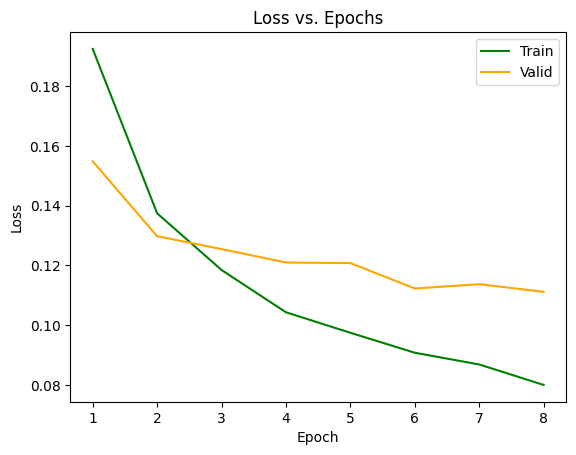

In [57]:
import torch
import torch.nn as nn

num_epochs=8
train_losses_per_epoch = []
val_losses_per_epoch = []

for epoch in range(num_epochs):
    train_loss = train_one_epoch(model, optimizer, train_loader, device, epoch)
    train_losses_per_epoch.append(train_loss)
    validation_loss  = evaluate_loss(model, val_loader, device=device)
    val_losses_per_epoch.append(validation_loss)

    
plt.plot(range(1, num_epochs + 1), train_losses_per_epoch, color='green', linestyle='-', label='Train')
plt.plot(range(1, num_epochs + 1), val_losses_per_epoch, color='orange', linestyle='-', label='Valid')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss vs. Epochs')
plt.legend()
plt.xticks(range(1, num_epochs + 1))
plt.grid(False)
plt.show()

In [58]:
from sklearn.metrics import classification_report

def get_predictions(model, loader, device):   
    model.eval()
    all_predicted_classes = []
    all_ground_truth_classes = []

    total_batches = len(loader)
    current_batch = 0
    with torch.no_grad():
       for images, targets in tqdm(loader, desc="Evaluating", total=total_batches):
            images = list(image.to(device) for image in images)
            predictions = model(images)
            
            for prediction, target in zip(predictions, targets):
                # Extract predicted and ground truth classes
                predicted_classes = prediction['labels'].cpu().numpy()
                ground_truth_classes = target['labels'].cpu().numpy()

                num_gt_predictions = len(ground_truth_classes)
                num_pred_to_keep = min(num_gt_predictions, len(predicted_classes))

                if num_pred_to_keep > 0:
                    # If there are multiple predictions, keep the most confident ones
                    scores = prediction['scores'].detach().cpu().numpy()
                    sorted_indices = np.argsort(scores)[::-1]

                    # Keep the most confident predictions up to the number of ground truths
                    most_confident_predictions = sorted_indices[:num_pred_to_keep]
                    predicted_classes = predicted_classes[most_confident_predictions]

                    # Pad the predicted classes if necessary
                    if len(predicted_classes) < num_gt_predictions:
                        padded_predictions = np.pad(predicted_classes, (0, num_gt_predictions - len(predicted_classes)), mode='constant')
                    else:
                        padded_predictions = predicted_classes
                        
                        
                else:
                    # If no predictions were made, pad with zeros
                    padded_predictions = np.random.randint(1, 13, size=num_gt_predictions) 
                    
                padded_predictions = np.sort(padded_predictions)
                ground_truth_classes = np.sort(ground_truth_classes)
                
                #print(padded_predictions)
                #print(ground_truth_classes)
                
                #Sort the truths and predictions
                all_predicted_classes.extend(padded_predictions)
                all_ground_truth_classes.extend(ground_truth_classes)
    return all_predicted_classes, all_ground_truth_classes

predicted_classes, ground_truth_classes = get_predictions(model, val_loader, device)
report = classification_report(ground_truth_classes, predicted_classes)
print(report)

"""{0: {'id': 0, 'name': 'Aircraft', 'supercategory': 'none'},
 1: {'id': 1, 'name': 'A-10 Thunderbolt', 'supercategory': 'Aircraft'},
 2: {'id': 2, 'name': 'ATR 72', 'supercategory': 'Aircraft'},
 3: {'id': 3, 'name': 'Airbus A320 Family', 'supercategory': 'Aircraft'},
 4: {'id': 4, 'name': 'Boeing 737', 'supercategory': 'Aircraft'},
 5: {'id': 5, 'name': 'Boeing 747', 'supercategory': 'Aircraft'},
 6: {'id': 6,
  'name': 'General Dynamics F-16 Fighting Falcon',
  'supercategory': 'Aircraft'},
 7: {'id': 7,
  'name': 'Lockheed Martin F-35 Lightning II',
  'supercategory': 'Aircraft'},
 8: {'id': 8, 'name': 'Lufthansa', 'supercategory': 'Aircraft'},
 9: {'id': 9, 'name': 'Military', 'supercategory': 'Aircraft'},
 10: {'id': 10,
  'name': 'Northrop Grumman B-2 Spirit',
  'supercategory': 'Aircraft'},
 11: {'id': 11, 'name': 'Other Airlines', 'supercategory': 'Aircraft'},
 12: {'id': 12, 'name': 'Ryanair', 'supercategory': 'Aircraft'}}"""
    

Evaluating: 100%|██████████| 180/180 [00:37<00:00,  4.84it/s]

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.84      0.59      0.69        71
           2       0.99      0.88      0.93        77
           3       0.89      0.98      0.93       130
           4       1.00      0.87      0.93       160
           5       0.88      0.92      0.90        71
           6       0.57      0.75      0.65       114
           7       0.69      0.38      0.49       119
           8       0.93      0.96      0.95        81
           9       0.81      0.85      0.83       392
          10       0.66      0.81      0.73        97
          11       0.98      0.97      0.98       305
          12       0.99      0.99      0.99        80

    accuracy                           0.85      1697
   macro avg       0.79      0.77      0.77      1697
weighted avg       0.86      0.85      0.85      1697



"{0: {'id': 0, 'name': 'Aircraft', 'supercategory': 'none'},\n 1: {'id': 1, 'name': 'A-10 Thunderbolt', 'supercategory': 'Aircraft'},\n 2: {'id': 2, 'name': 'ATR 72', 'supercategory': 'Aircraft'},\n 3: {'id': 3, 'name': 'Airbus A320 Family', 'supercategory': 'Aircraft'},\n 4: {'id': 4, 'name': 'Boeing 737', 'supercategory': 'Aircraft'},\n 5: {'id': 5, 'name': 'Boeing 747', 'supercategory': 'Aircraft'},\n 6: {'id': 6,\n  'name': 'General Dynamics F-16 Fighting Falcon',\n  'supercategory': 'Aircraft'},\n 7: {'id': 7,\n  'name': 'Lockheed Martin F-35 Lightning II',\n  'supercategory': 'Aircraft'},\n 8: {'id': 8, 'name': 'Lufthansa', 'supercategory': 'Aircraft'},\n 9: {'id': 9, 'name': 'Military', 'supercategory': 'Aircraft'},\n 10: {'id': 10,\n  'name': 'Northrop Grumman B-2 Spirit',\n  'supercategory': 'Aircraft'},\n 11: {'id': 11, 'name': 'Other Airlines', 'supercategory': 'Aircraft'},\n 12: {'id': 12, 'name': 'Ryanair', 'supercategory': 'Aircraft'}}"

In [59]:
def get_boxes(model, val_loader, device):
    predicted_classes = []
    predicted_boxes = []
    ground_truth_classes = []
    ground_truth_boxes = []
    
    model.eval()
    with torch.no_grad():
        for images, targets in val_loader:
            images = list(image.to(device) for image in images)
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            # Forward pass
            outputs = model(images)
            
            # Post-process the outputs to get classes and bounding boxes
            for i in range(len(outputs)):
                pred_boxes = outputs[i]['boxes'].detach().cpu().numpy()
                gt_boxes = targets[i]['boxes'].cpu().numpy()
                
                predicted_boxes.append(pred_boxes)
                ground_truth_boxes.append(gt_boxes)
    
    return predicted_boxes, ground_truth_boxes

predicted_boxes, ground_truth_boxes = get_boxes(model, val_loader, device)


def calculate_iou(box1, box2):
    # Extract coordinates
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    
    # Calculate intersection coordinates
    x_left = max(x1, x2)
    y_top = max(y1, y2)
    x_right = min(x1 + w1, x2 + w2)
    y_bottom = min(y1 + h1, y2 + h2)
    
    # Calculate intersection area
    intersection_area = max(0, x_right - x_left) * max(0, y_bottom - y_top)
    
    # Calculate union area
    box1_area = w1 * h1
    box2_area = w2 * h2
    union_area = box1_area + box2_area - intersection_area
    
    # Calculate IOU
    iou = intersection_area / union_area if union_area > 0 else 0
    
    return iou

In [60]:
def calculate_map50(predicted_boxes, ground_truth_boxes):
    # Define IOU threshold
    iou_threshold = 0.5
    
    # Initialize lists to store precision values for each class
    precision_list = []
    
    # Iterate over each image
    for pred_boxes, gt_boxes in zip(predicted_boxes, ground_truth_boxes):
        # Initialize lists to store IOU values for this image
        ious = []
        
        # Iterate over each predicted box
        for pred_box in pred_boxes:
            # Calculate IOU values for this predicted box with respect to all ground truth boxes
            iou_values = [calculate_iou(pred_box, gt_box) for gt_box in gt_boxes]
            ious.append(iou_values)
        
        # Assign ground truth and predicted scores
        y_true = [1 if max(iou_values) >= iou_threshold else 0 for iou_values in ious]
        y_scores = np.ones(len(pred_boxes))  # Assuming all predictions have confidence score 1
        
        # Calculate precision for this image
        precision = np.sum(y_true) / len(y_true) if len(y_true) > 0 else 0
        precision_list.append(precision)
    
    # Compute mean precision across all images
    mAP50 = np.mean(precision_list)
    
    return mAP50

mAP50 = calculate_map50(predicted_boxes, ground_truth_boxes)
print("mAP50:", mAP50)

mAP50: 0.8270233834931485


In [61]:
from sklearn.metrics import average_precision_score
from sklearn.preprocessing import label_binarize
import numpy as np

# Define the class dictionary
class_dict = {
    0: {'id': 0, 'name': 'Aircraft', 'supercategory': 'none'},
    1: {'id': 1, 'name': 'A-10 Thunderbolt', 'supercategory': 'Aircraft'},
    2: {'id': 2, 'name': 'ATR 72', 'supercategory': 'Aircraft'},
    3: {'id': 3, 'name': 'Airbus A320 Family', 'supercategory': 'Aircraft'},
    4: {'id': 4, 'name': 'Boeing 737', 'supercategory': 'Aircraft'},
    5: {'id': 5, 'name': 'Boeing 747', 'supercategory': 'Aircraft'},
    6: {'id': 6, 'name': 'General Dynamics F-16 Fighting Falcon', 'supercategory': 'Aircraft'},
    7: {'id': 7, 'name': 'Lockheed Martin F-35 Lightning II', 'supercategory': 'Aircraft'},
    8: {'id': 8, 'name': 'Lufthansa', 'supercategory': 'Aircraft'},
    9: {'id': 9, 'name': 'Military', 'supercategory': 'Aircraft'},
    10: {'id': 10, 'name': 'Northrop Grumman B-2 Spirit', 'supercategory': 'Aircraft'},
    11: {'id': 11, 'name': 'Other Airlines', 'supercategory': 'Aircraft'},
    12: {'id': 12, 'name': 'Ryanair', 'supercategory': 'Aircraft'}
}

predicted_classes, ground_truth_classes = get_predictions(model, val_loader, device)

predicted_classes_array = np.array(predicted_classes)
ground_truth_classes_array = np.array(ground_truth_classes)

# Binarize the ground truth labels
num_classes = np.max(predicted_classes_array) + 1
ground_truth_binarized = label_binarize(ground_truth_classes_array, classes=range(num_classes))

# Compute average precision for each class
average_precisions = []
for i in range(num_classes):
    # Filter samples where predicted class matches i
    relevant_indices = np.where(predicted_classes_array == i)[0]
    
    average_precision = 0.0  # Initialize average_precision to 0.0
    
    if len(relevant_indices) != 0:
        relevant_ground_truth = ground_truth_binarized[relevant_indices]
        
        # Calculate average precision for the current class
        average_precision = average_precision_score(relevant_ground_truth[:, i], 
                                                    predicted_classes_array[relevant_indices] == i)
    average_precisions.append(average_precision)

    # Get class name from class dictionary
    class_name = class_dict[i]['name']

    # Print average precision for the current class
    print(f"Average Precision for {class_name}: {average_precision}")

# Compute mean average precision (MAP)
map_score = np.mean(average_precisions)

print("Mean Average Precision (MAP):", map_score)

Evaluating: 100%|██████████| 180/180 [00:37<00:00,  4.84it/s]

Average Precision for Aircraft: -0.0
Average Precision for A-10 Thunderbolt: 0.84
Average Precision for ATR 72: 1.0
Average Precision for Airbus A320 Family: 0.8888888888888888
Average Precision for Boeing 737: 1.0
Average Precision for Boeing 747: 0.8783783783783784
Average Precision for General Dynamics F-16 Fighting Falcon: 0.5657894736842105
Average Precision for Lockheed Martin F-35 Lightning II: 0.6923076923076923
Average Precision for Lufthansa: 0.9285714285714286
Average Precision for Military: 0.8067632850241546
Average Precision for Northrop Grumman B-2 Spirit: 0.6638655462184874
Average Precision for Other Airlines: 0.9769736842105263
Average Precision for Ryanair: 1.0
Mean Average Precision (MAP): 0.7878106444064437


In [62]:
test_dataset = AircraftDetection(root=dataset_path, split="test", transforms=get_transforms(False))

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


Boeing 737: 0.66
Ryanair: 0.57


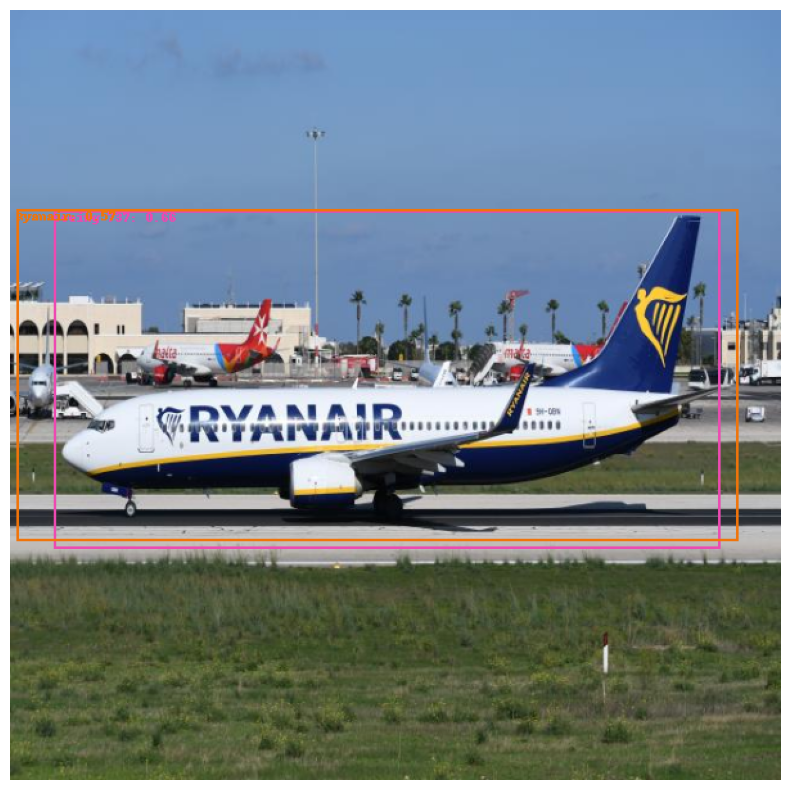

[4]
ATR 72: 0.65
Other Airlines: 0.62


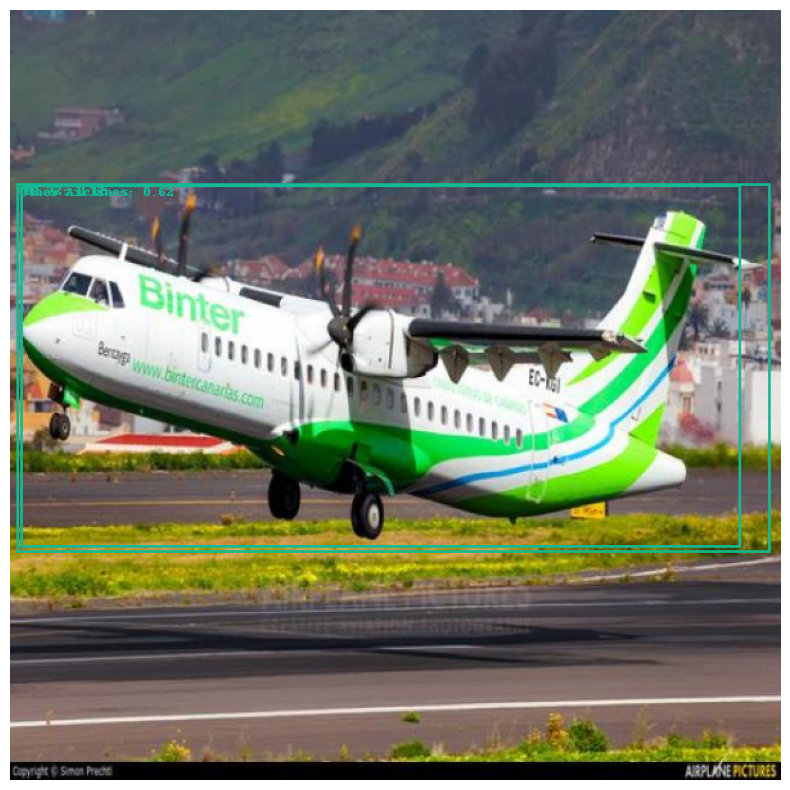

[4, 2]
Other Airlines: 0.73
ATR 72: 0.40
Boeing 747: 0.07


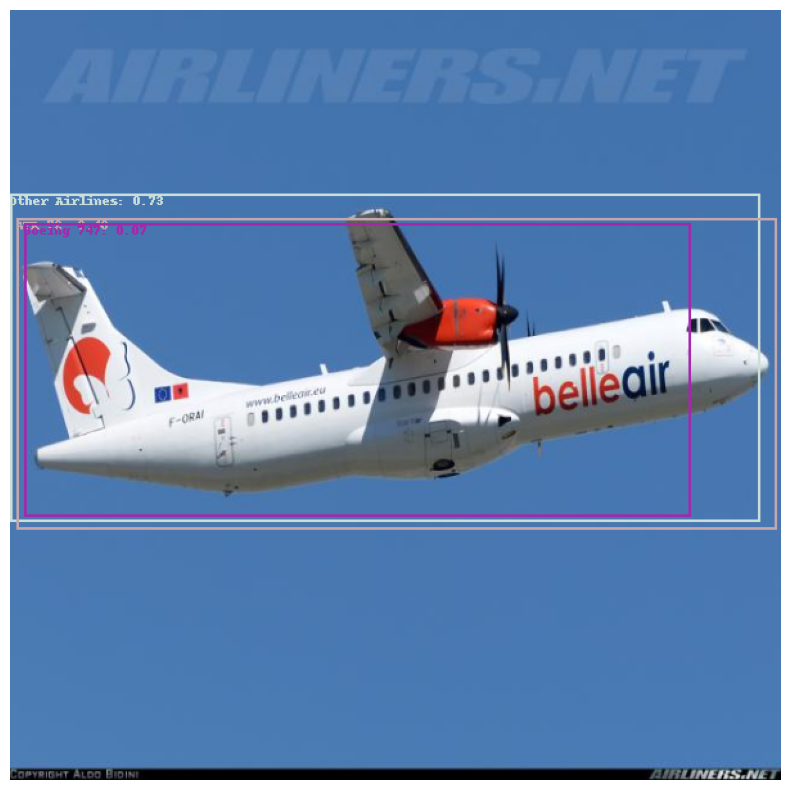

[4, 2, 11]
Boeing 737: 0.72
Ryanair: 0.45
Other Airlines: 0.06


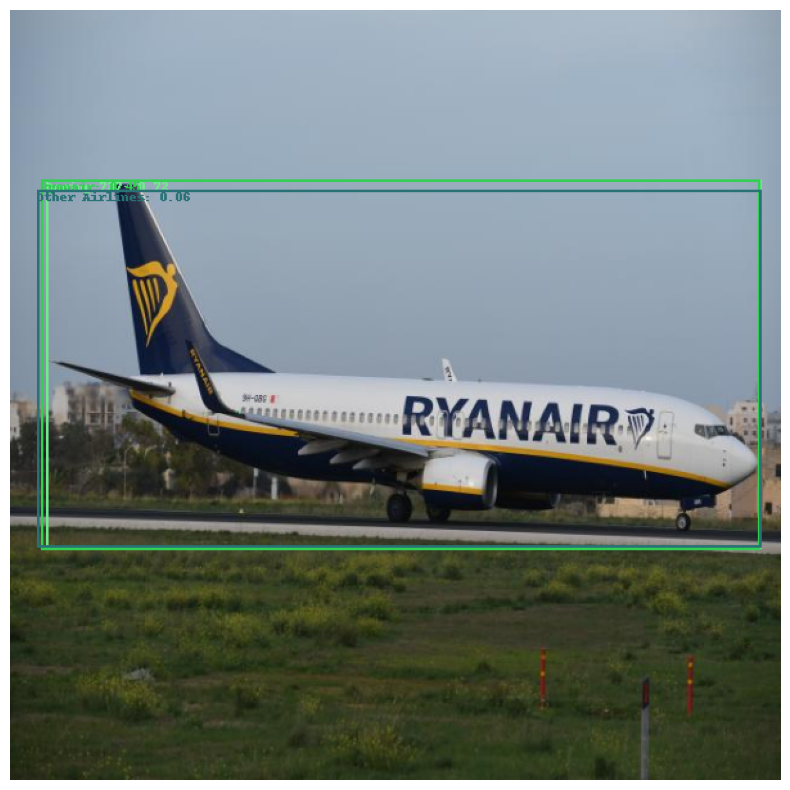

[4, 2, 11, 4]
Airbus A320 Family: 0.64
Other Airlines: 0.50
Boeing 737: 0.07


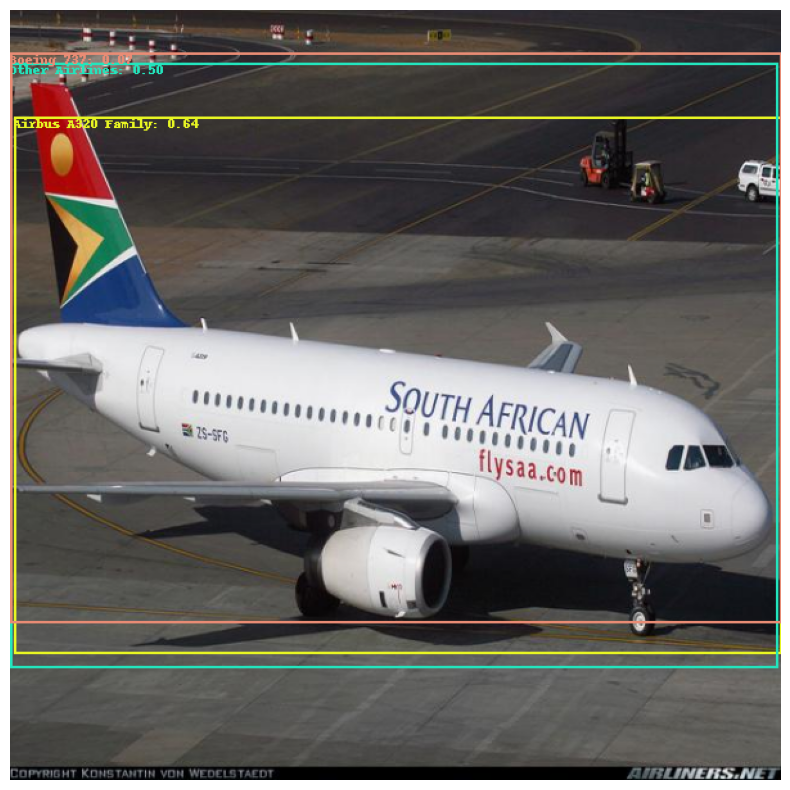

[4, 2, 11, 4, 3]
Boeing 737: 0.69
Ryanair: 0.49


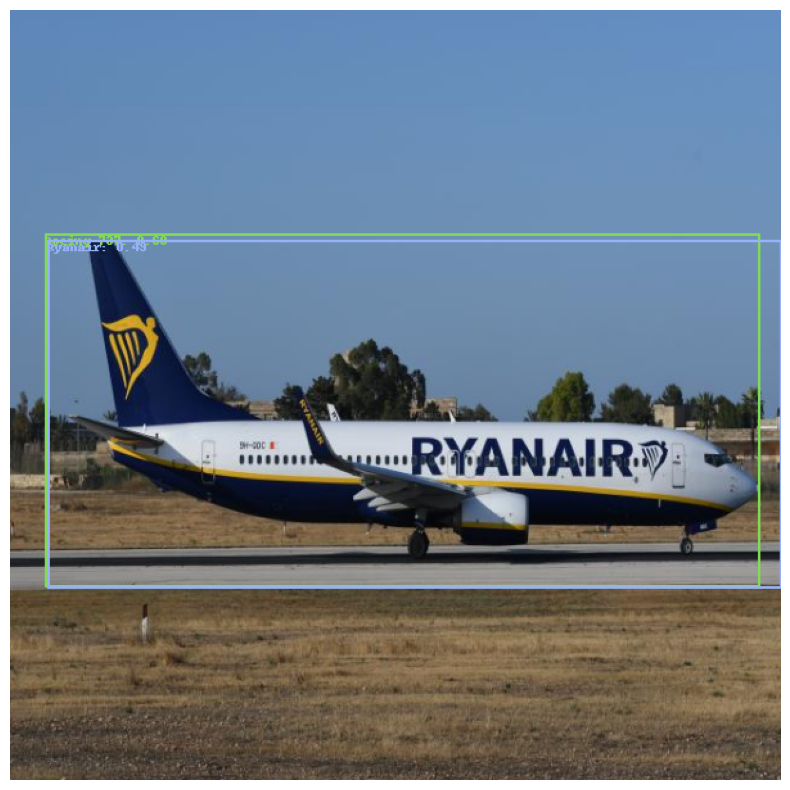

[4, 2, 11, 4, 3, 4]
Other Airlines: 0.67
ATR 72: 0.64


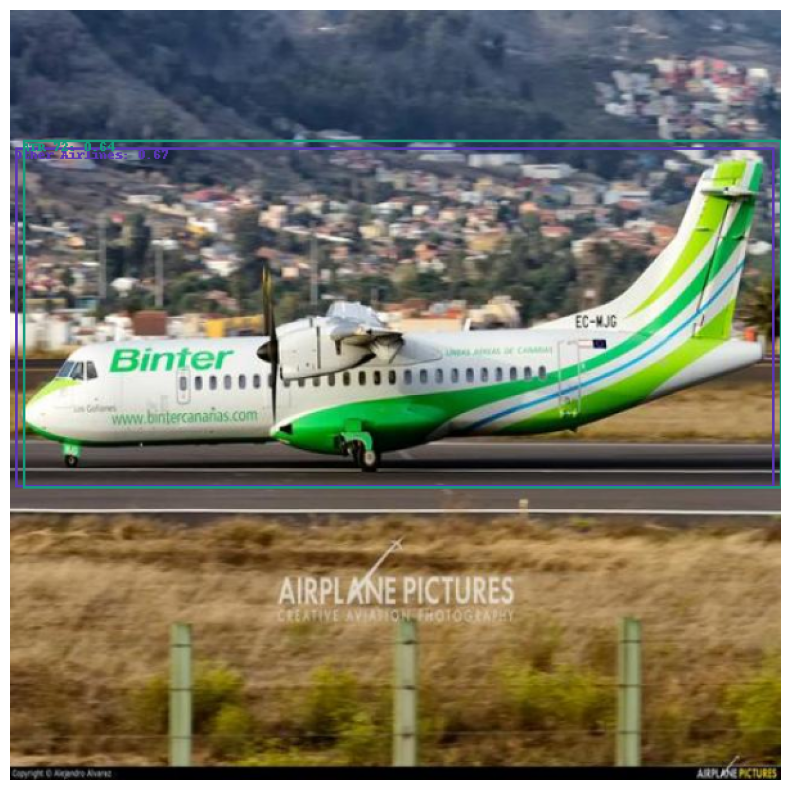

[4, 2, 11, 4, 3, 4, 11]
Airbus A320 Family: 0.73
Other Airlines: 0.33
Lufthansa: 0.21


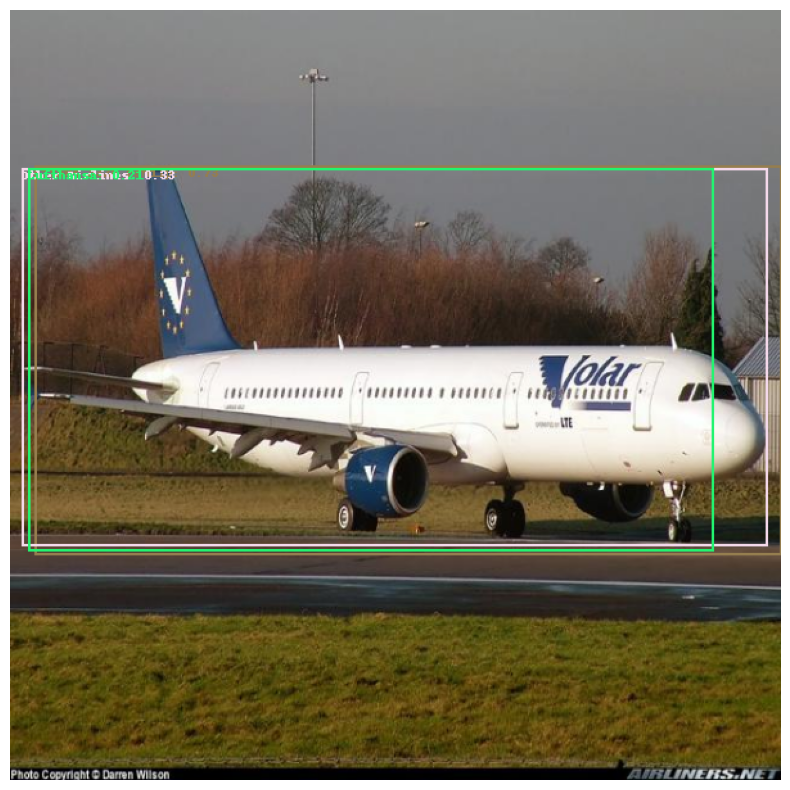

[4, 2, 11, 4, 3, 4, 11, 3]
Boeing 737: 0.68
Ryanair: 0.42
Other Airlines: 0.11


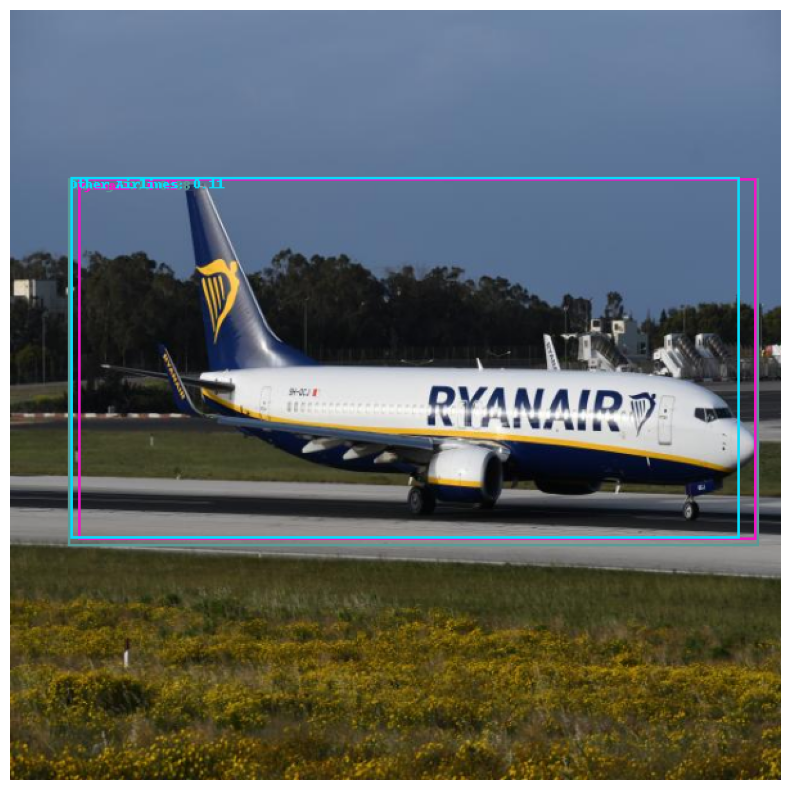

[4, 2, 11, 4, 3, 4, 11, 3, 4]
A-10 Thunderbolt: 0.55
Military: 0.41
Military: 0.20
A-10 Thunderbolt: 0.16
Other Airlines: 0.13
Airbus A320 Family: 0.10


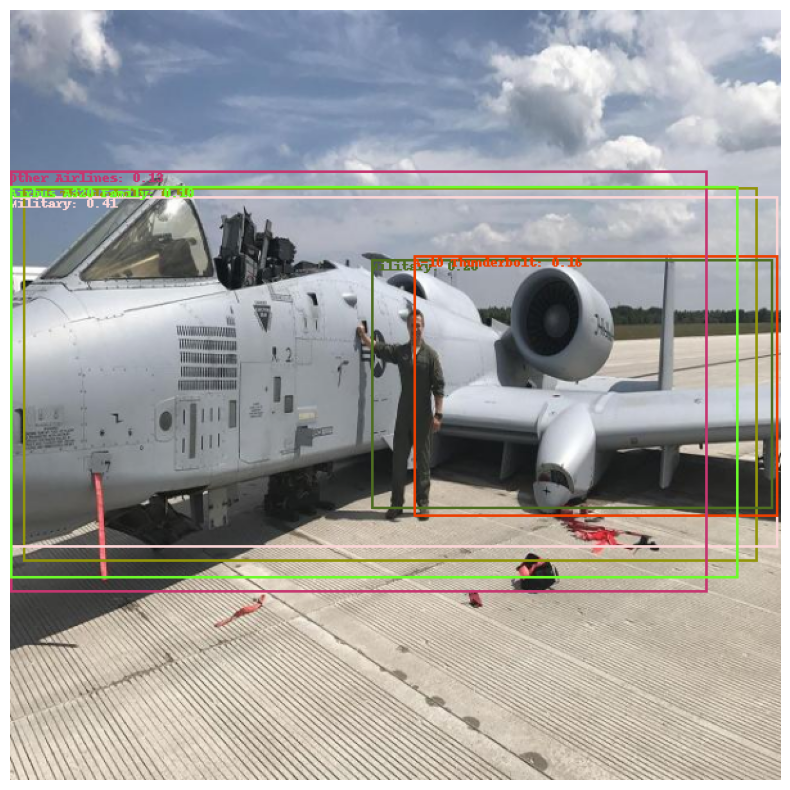

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1]
Other Airlines: 0.65
Boeing 747: 0.59
Lufthansa: 0.06


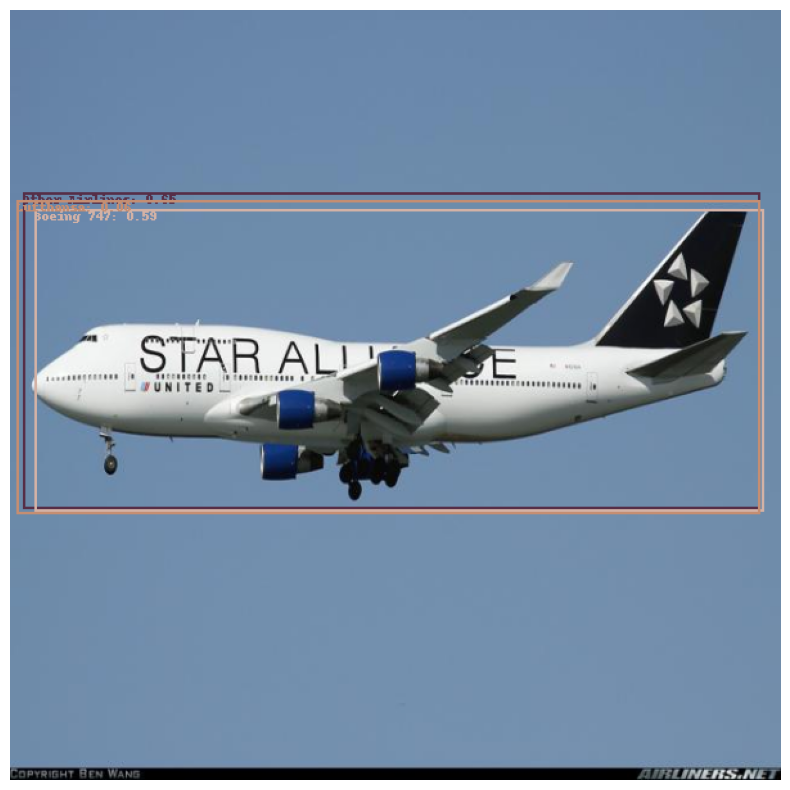

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11]
Northrop Grumman B-2 Spirit: 0.67
Military: 0.49


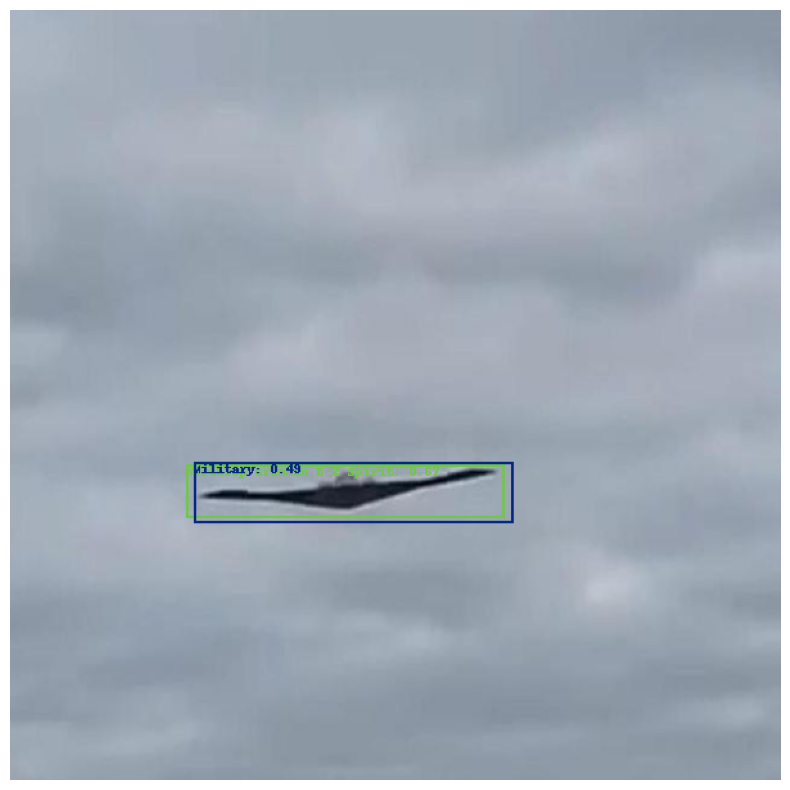

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10]
Boeing 737: 0.72
Ryanair: 0.52


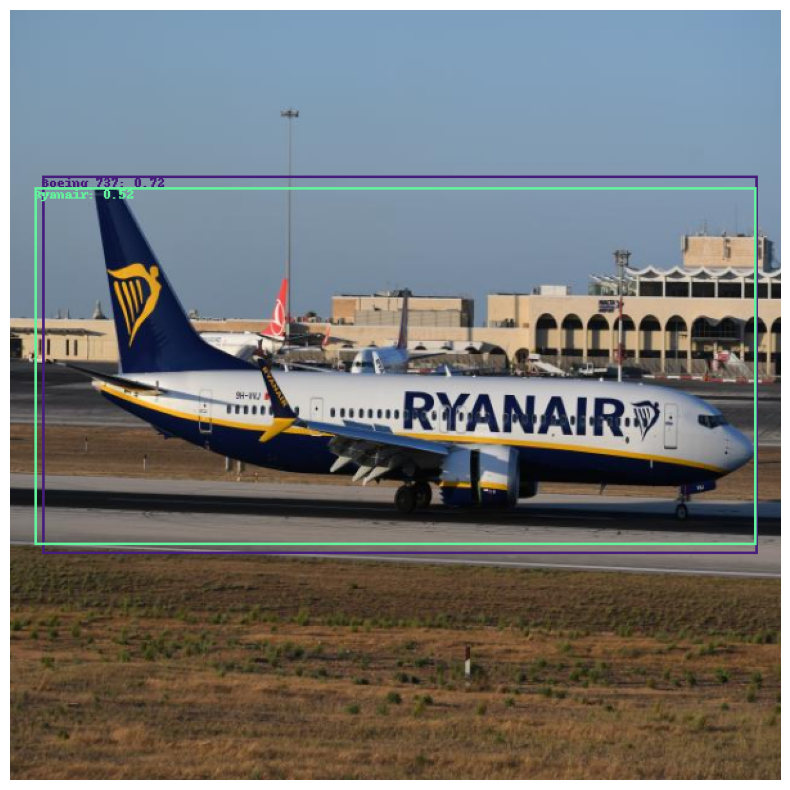

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4]
General Dynamics F-16 Fighting Falcon: 0.65
Military: 0.46
A-10 Thunderbolt: 0.05


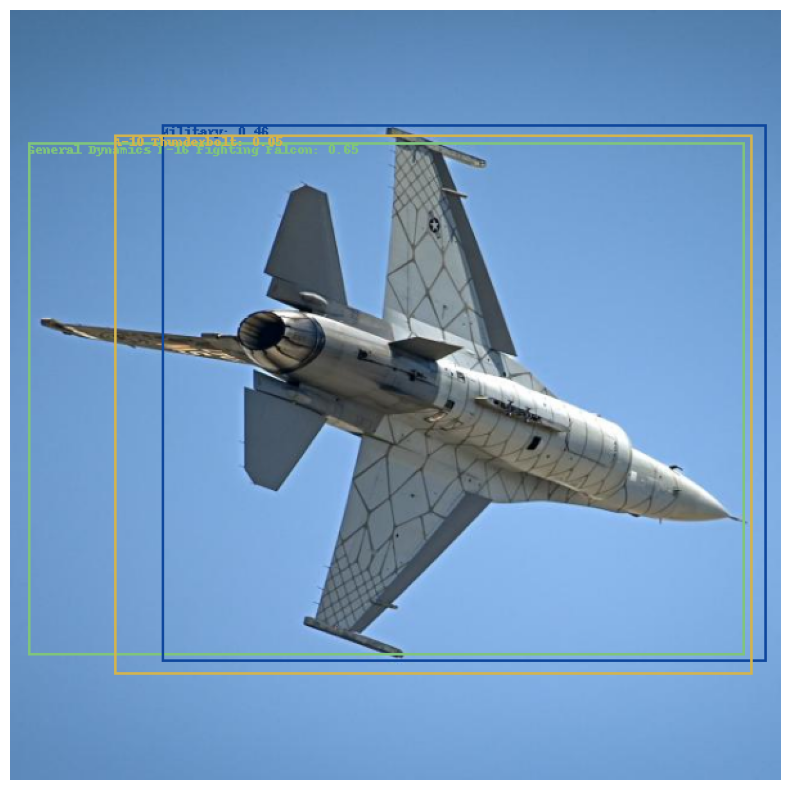

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6]
Boeing 747: 0.68
Other Airlines: 0.62
General Dynamics F-16 Fighting Falcon: 0.24
Military: 0.19
Other Airlines: 0.13
Boeing 737: 0.11
Northrop Grumman B-2 Spirit: 0.07


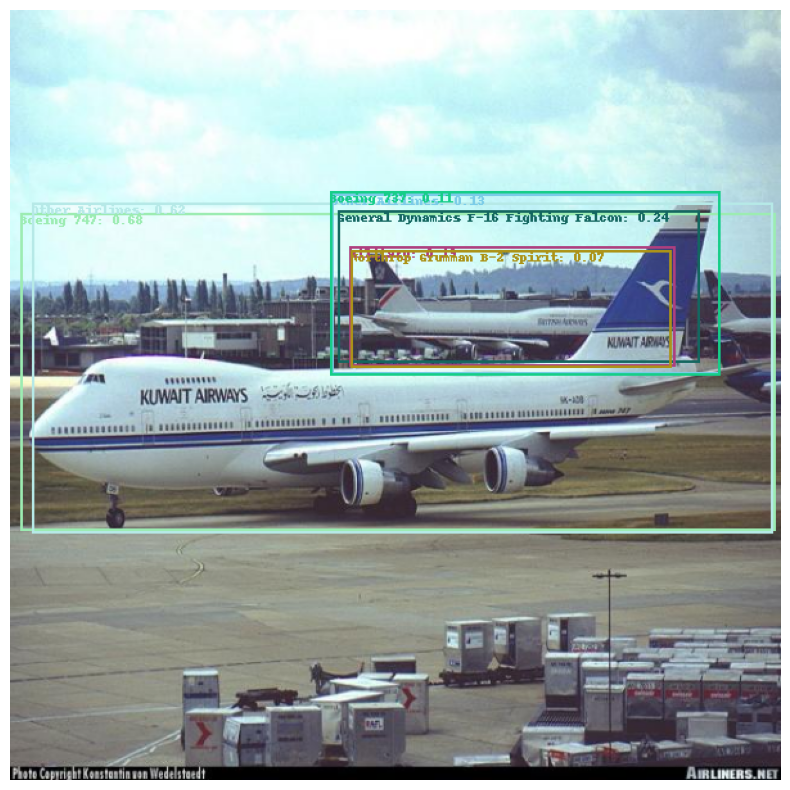

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5]
Lufthansa: 0.62
Airbus A320 Family: 0.57
Other Airlines: 0.08


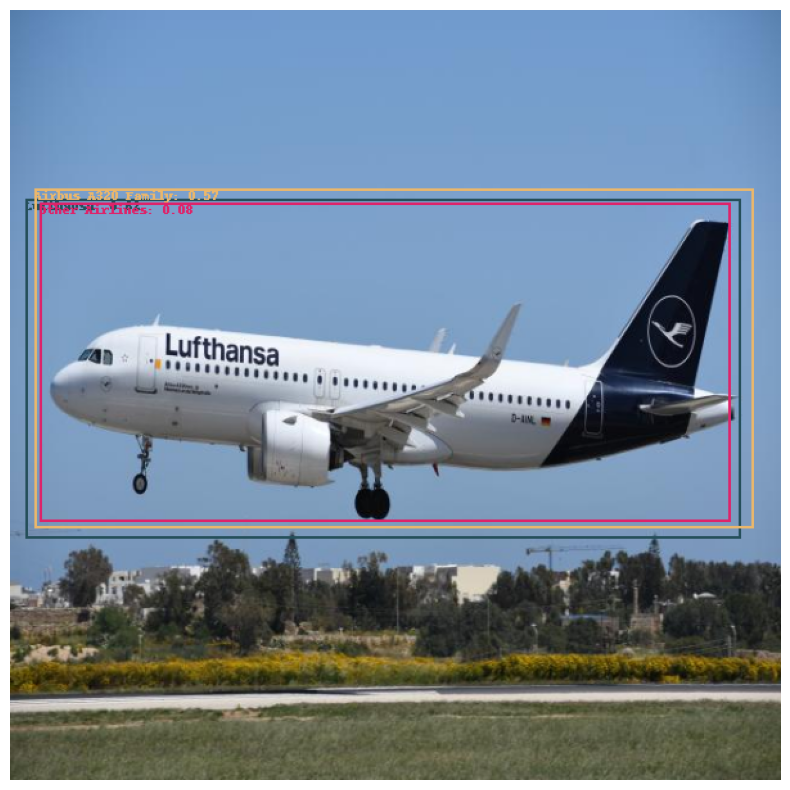

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8]
General Dynamics F-16 Fighting Falcon: 0.47
Military: 0.45
Military: 0.22
Lockheed Martin F-35 Lightning II: 0.16
Lockheed Martin F-35 Lightning II: 0.10
Military: 0.05
Northrop Grumman B-2 Spirit: 0.05


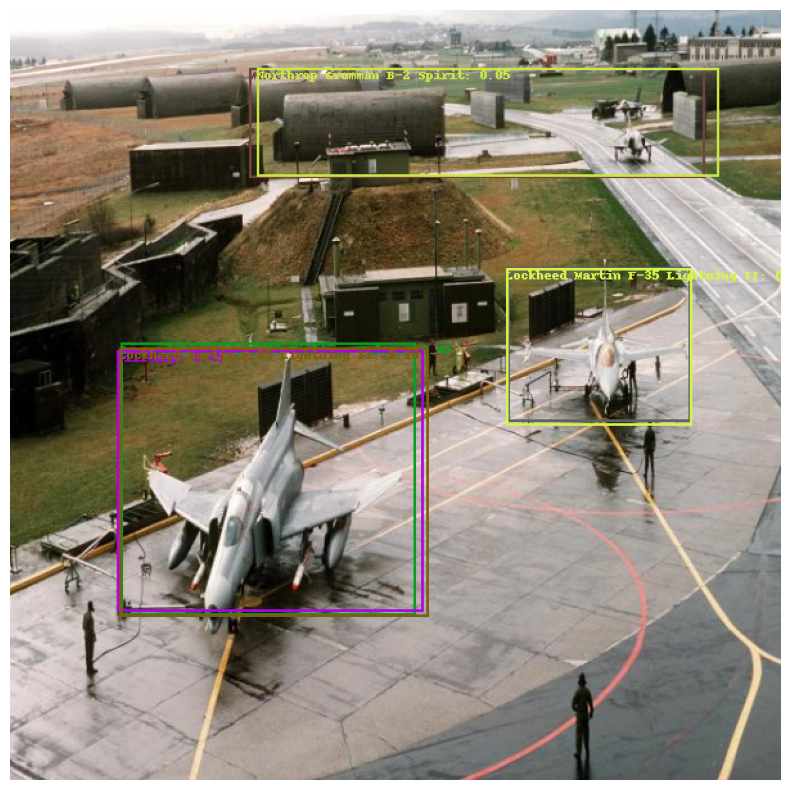

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6]
Military: 0.62
General Dynamics F-16 Fighting Falcon: 0.53
Military: 0.47
General Dynamics F-16 Fighting Falcon: 0.36
A-10 Thunderbolt: 0.34
Lockheed Martin F-35 Lightning II: 0.33
General Dynamics F-16 Fighting Falcon: 0.06
Military: 0.05


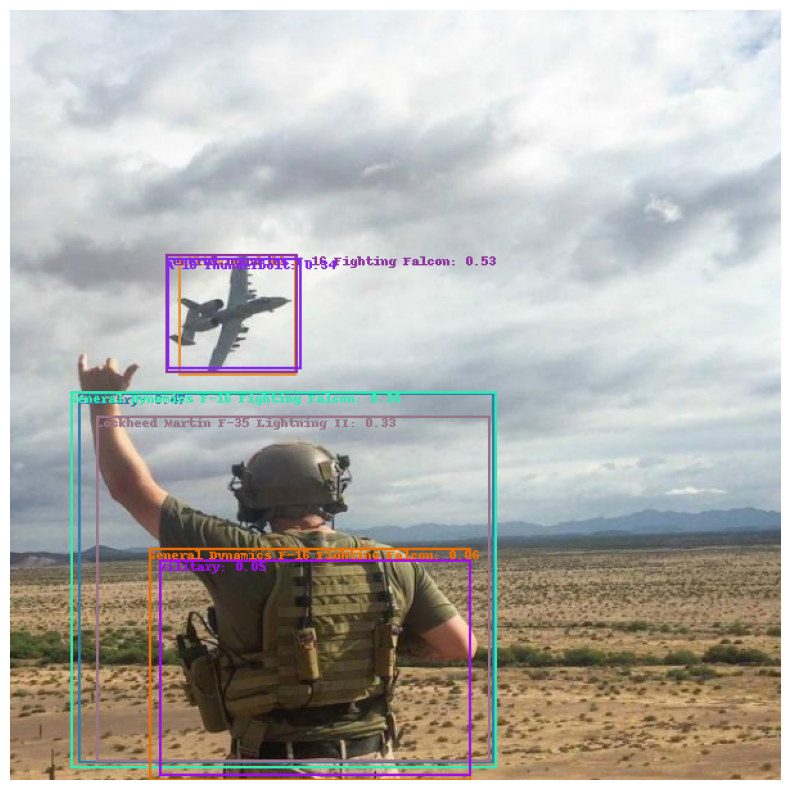

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9]
Other Airlines: 0.71
Airbus A320 Family: 0.39
Boeing 747: 0.27
ATR 72: 0.11
Other Airlines: 0.07
Boeing 737: 0.07
A-10 Thunderbolt: 0.06


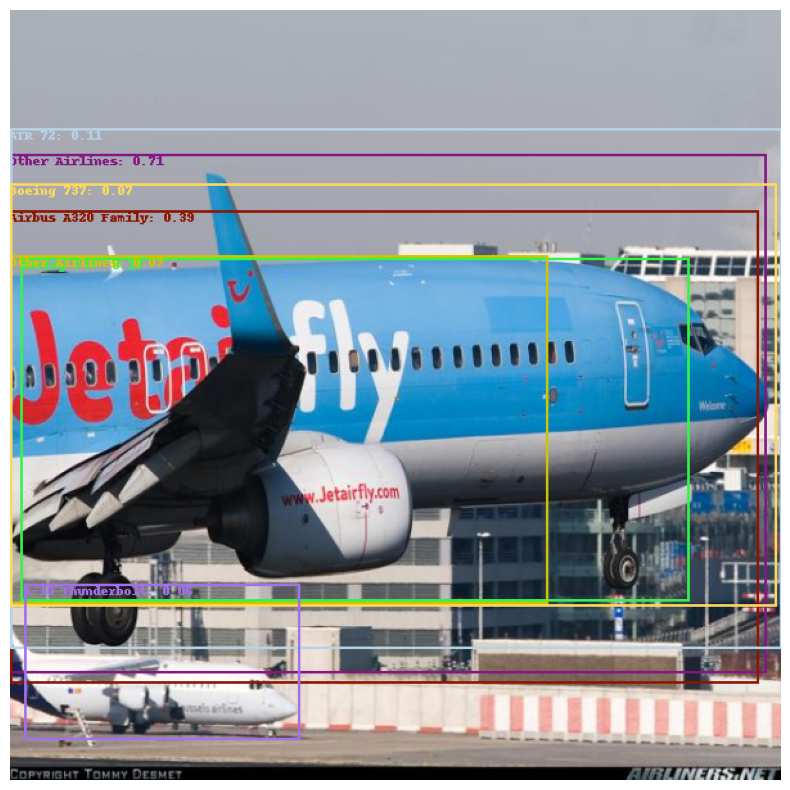

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11]
Military: 0.64
Military: 0.63
Military: 0.61
Military: 0.52
Military: 0.48
General Dynamics F-16 Fighting Falcon: 0.32
Lockheed Martin F-35 Lightning II: 0.29
Lockheed Martin F-35 Lightning II: 0.28
Lockheed Martin F-35 Lightning II: 0.26
Military: 0.22
Military: 0.22
General Dynamics F-16 Fighting Falcon: 0.21
Lockheed Martin F-35 Lightning II: 0.20
Military: 0.18
General Dynamics F-16 Fighting Falcon: 0.15
Northrop Grumman B-2 Spirit: 0.13
Lockheed Martin F-35 Lightning II: 0.13
Military: 0.13
Lockheed Martin F-35 Lightning II: 0.13
Lockheed Martin F-35 Lightning II: 0.11
Military: 0.09
General Dynamics F-16 Fighting Falcon: 0.09
General Dynamics F-16 Fighting Falcon: 0.09
Military: 0.08
General Dynamics F-16 Fighting Falcon: 0.08
Northrop Grumman B-2 Spirit: 0.07
General Dynamics F-16 Fighting Falcon: 0.07
Northrop Grumman B-2 Spirit: 0.06
Northrop Grumman B-2 Spirit: 0.05


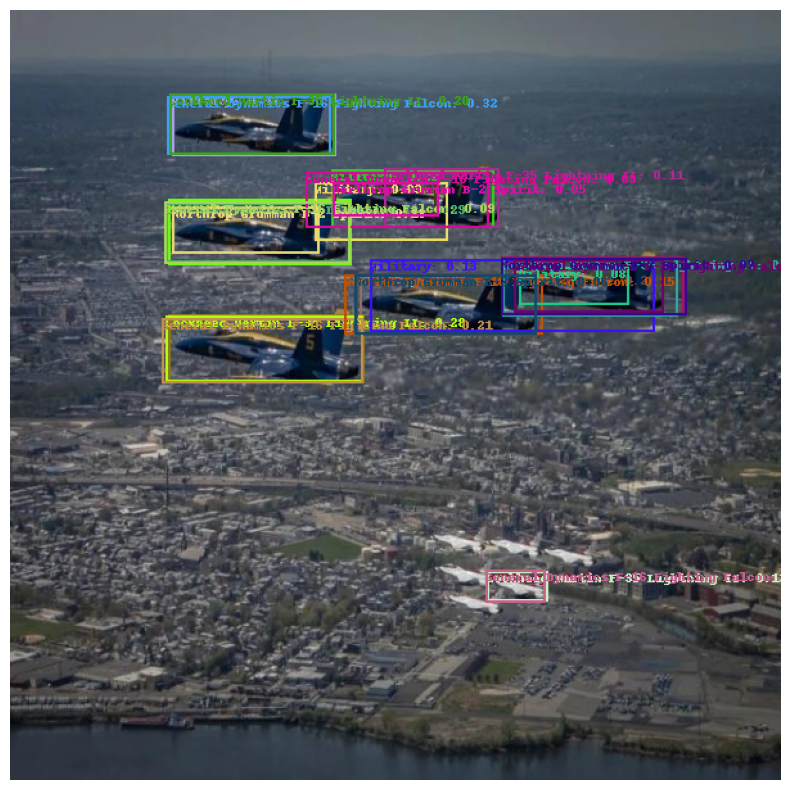

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9]
Other Airlines: 0.62
Airbus A320 Family: 0.58
Lufthansa: 0.06


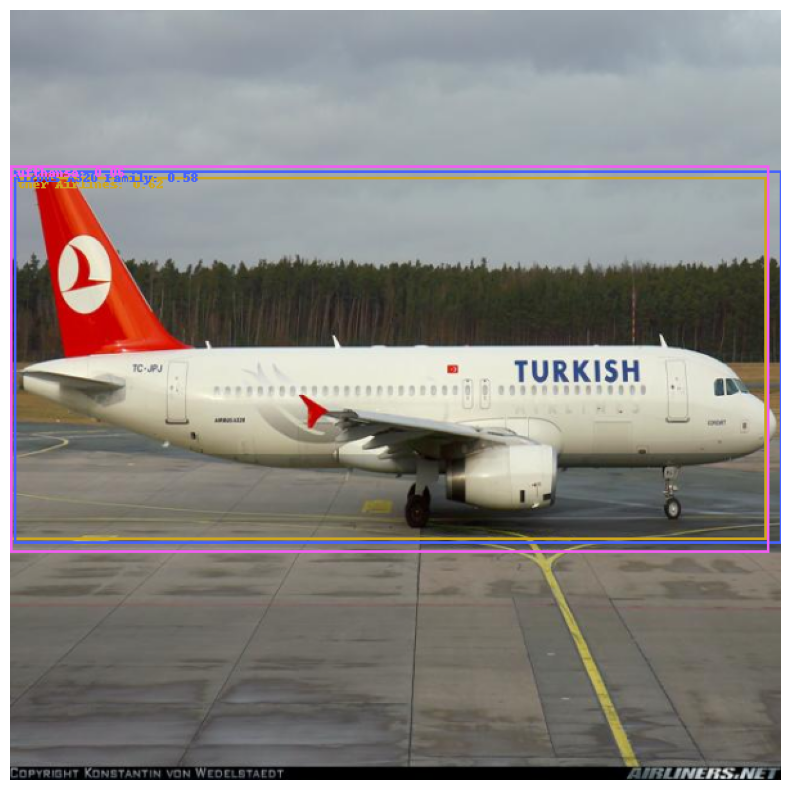

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11]
Other Airlines: 0.70
ATR 72: 0.64
Boeing 737: 0.08


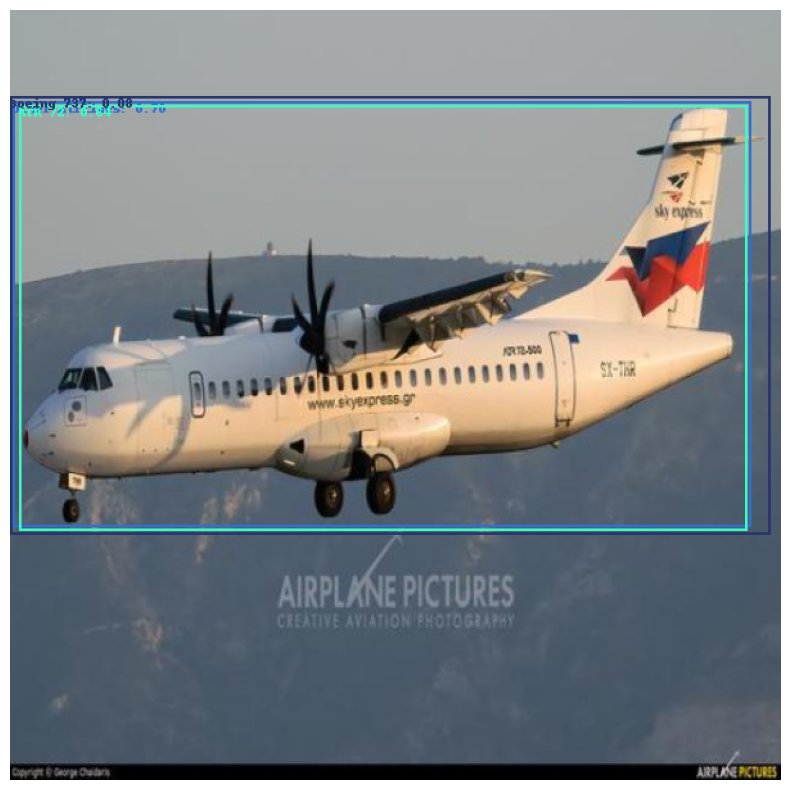

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11]
Lufthansa: 0.73
Airbus A320 Family: 0.52
Northrop Grumman B-2 Spirit: 0.07


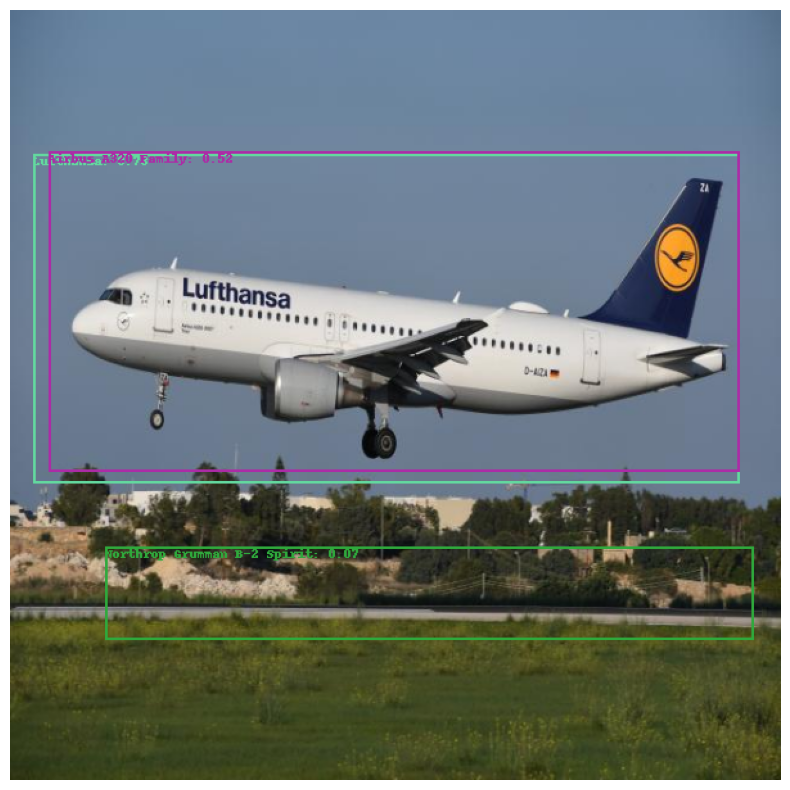

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8]
Other Airlines: 0.65
ATR 72: 0.60


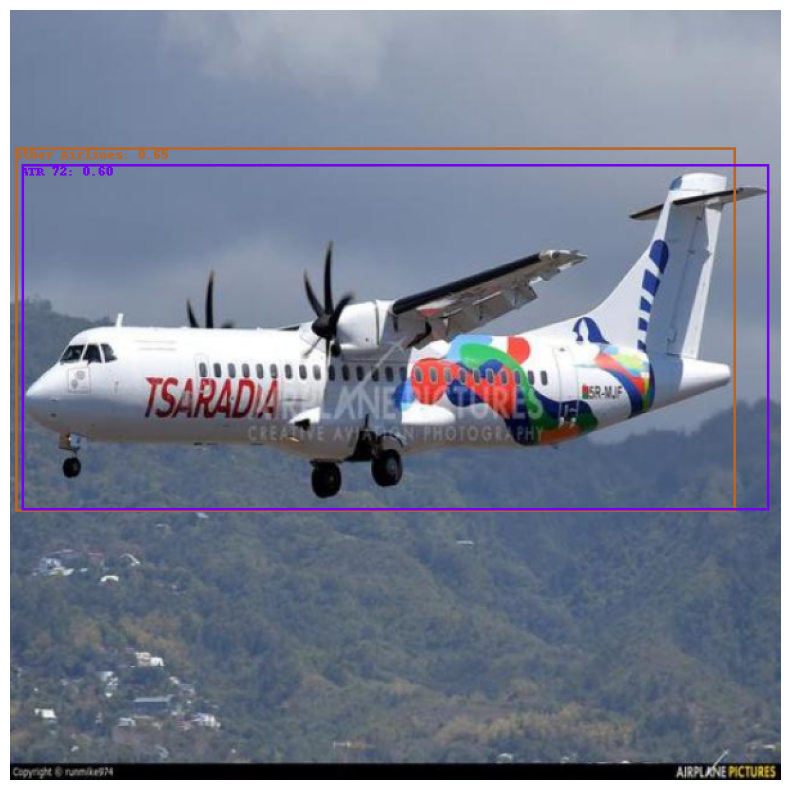

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11]
Military: 0.62
Lockheed Martin F-35 Lightning II: 0.52
Northrop Grumman B-2 Spirit: 0.09


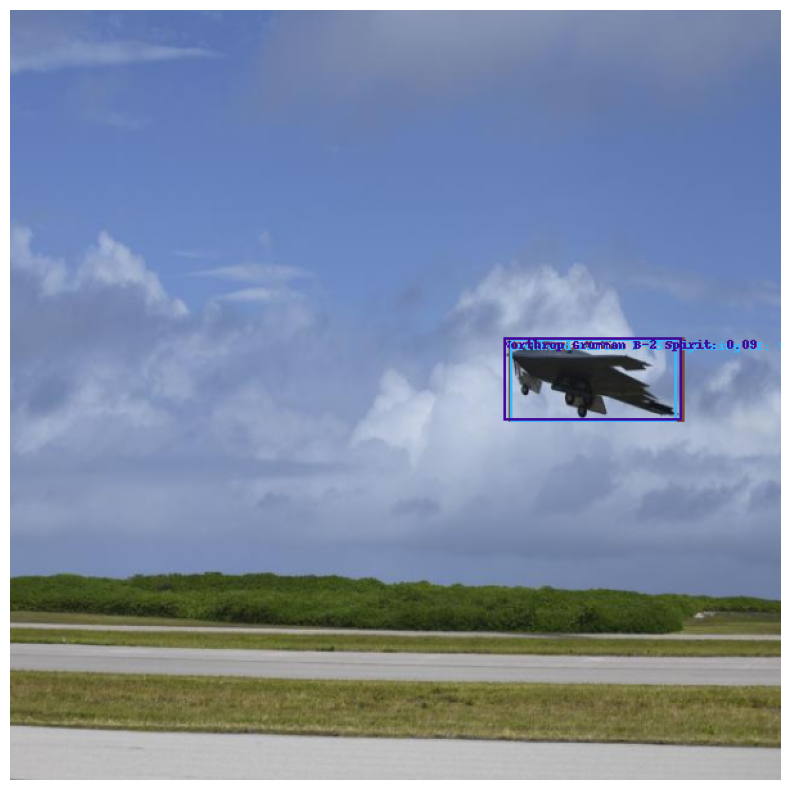

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9]
General Dynamics F-16 Fighting Falcon: 0.63
Military: 0.61
Military: 0.60
Lockheed Martin F-35 Lightning II: 0.51
Military: 0.51
Military: 0.44
General Dynamics F-16 Fighting Falcon: 0.40
Lockheed Martin F-35 Lightning II: 0.20
General Dynamics F-16 Fighting Falcon: 0.19
Military: 0.17
Military: 0.14
Military: 0.11
General Dynamics F-16 Fighting Falcon: 0.10
General Dynamics F-16 Fighting Falcon: 0.10
Lockheed Martin F-35 Lightning II: 0.07
General Dynamics F-16 Fighting Falcon: 0.07
General Dynamics F-16 Fighting Falcon: 0.06
A-10 Thunderbolt: 0.05
Military: 0.05


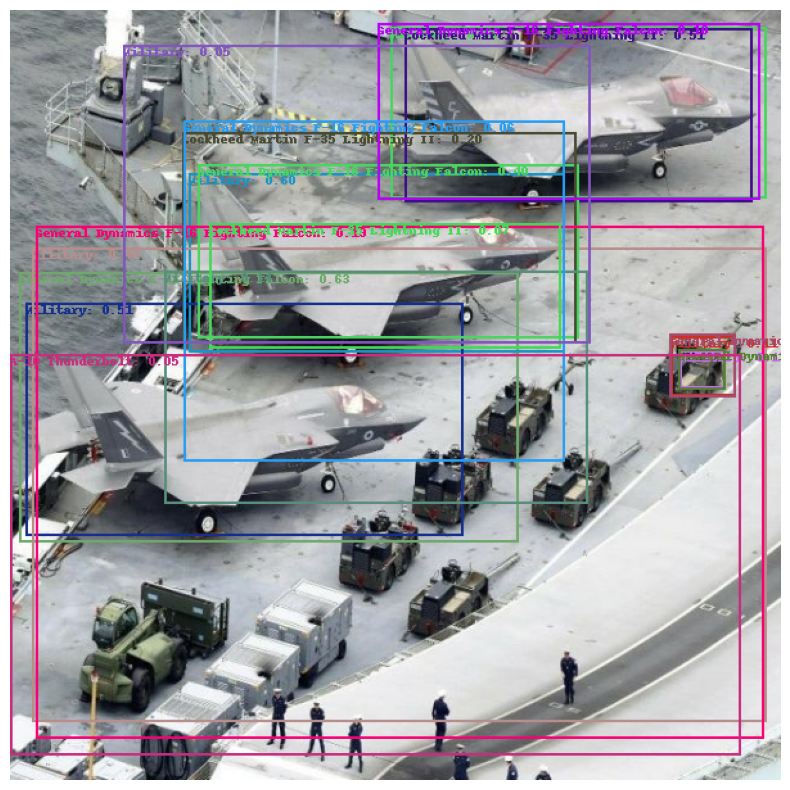

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6]
Airbus A320 Family: 0.64
Other Airlines: 0.53
Lufthansa: 0.11


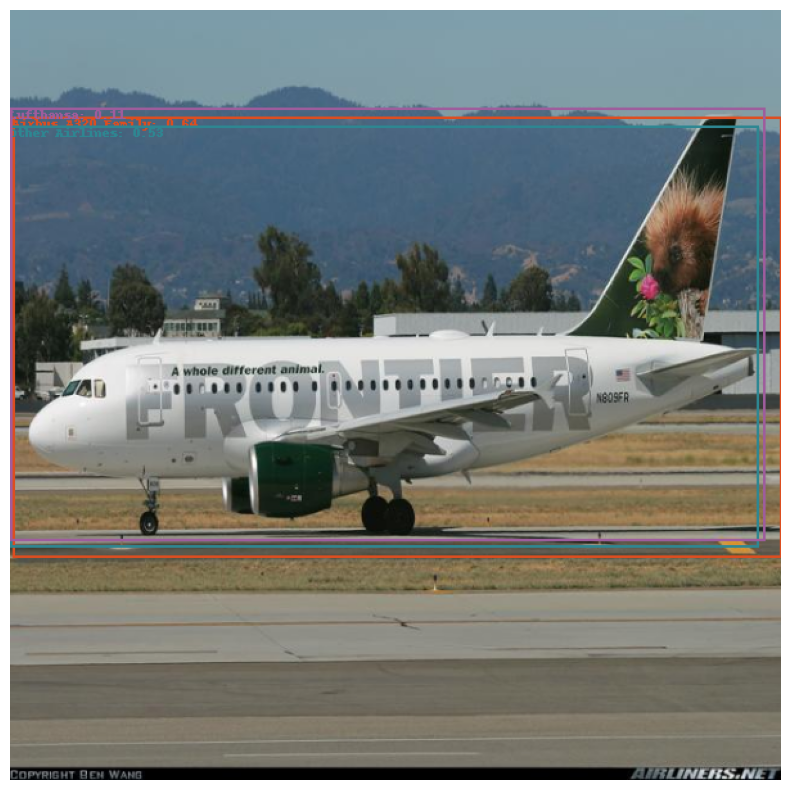

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3]
Military: 0.52
Military: 0.50
General Dynamics F-16 Fighting Falcon: 0.47
General Dynamics F-16 Fighting Falcon: 0.35
Lockheed Martin F-35 Lightning II: 0.25
Lockheed Martin F-35 Lightning II: 0.17


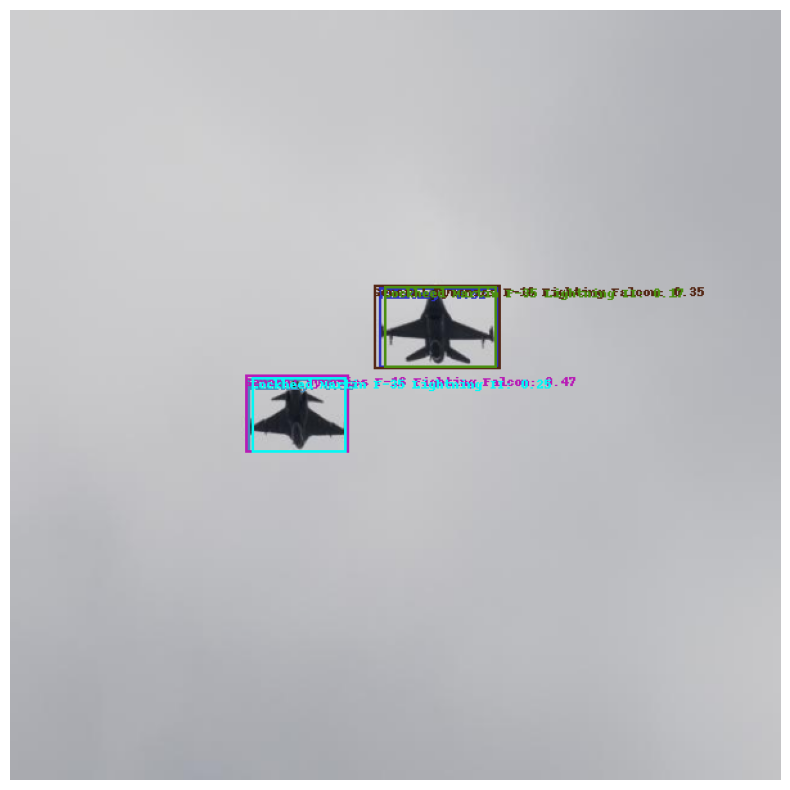

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9]
Other Airlines: 0.67
ATR 72: 0.62


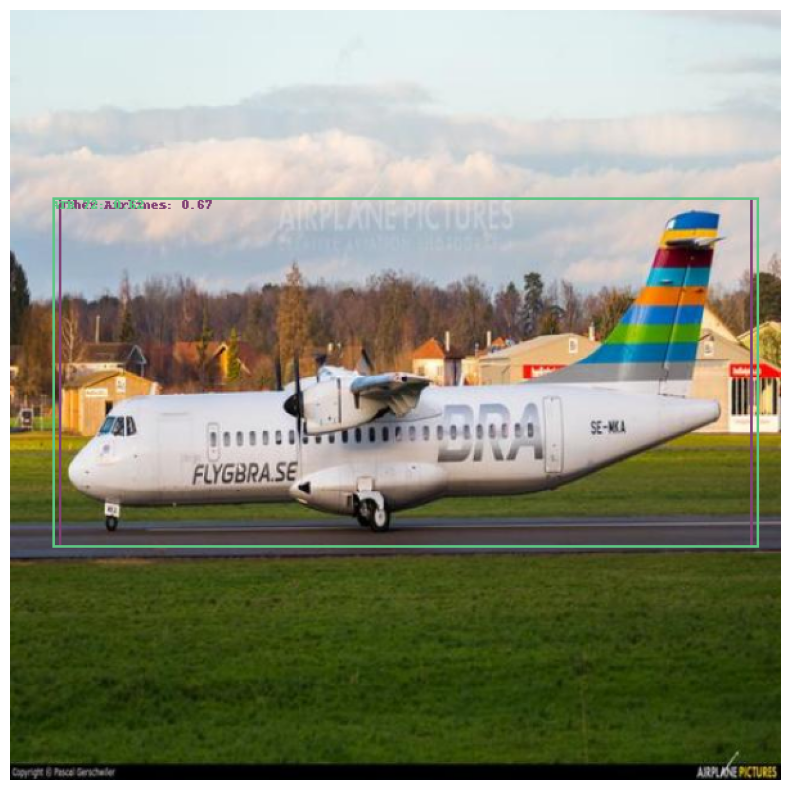

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11]
Northrop Grumman B-2 Spirit: 0.78
Military: 0.42
Military: 0.16
Northrop Grumman B-2 Spirit: 0.05


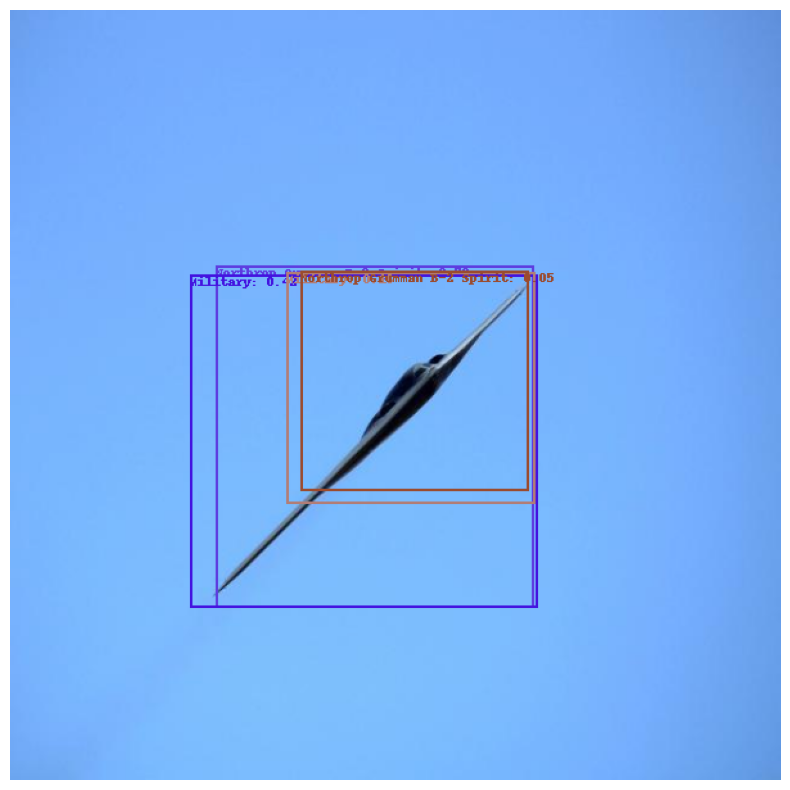

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10]
Boeing 747: 0.72
Other Airlines: 0.61


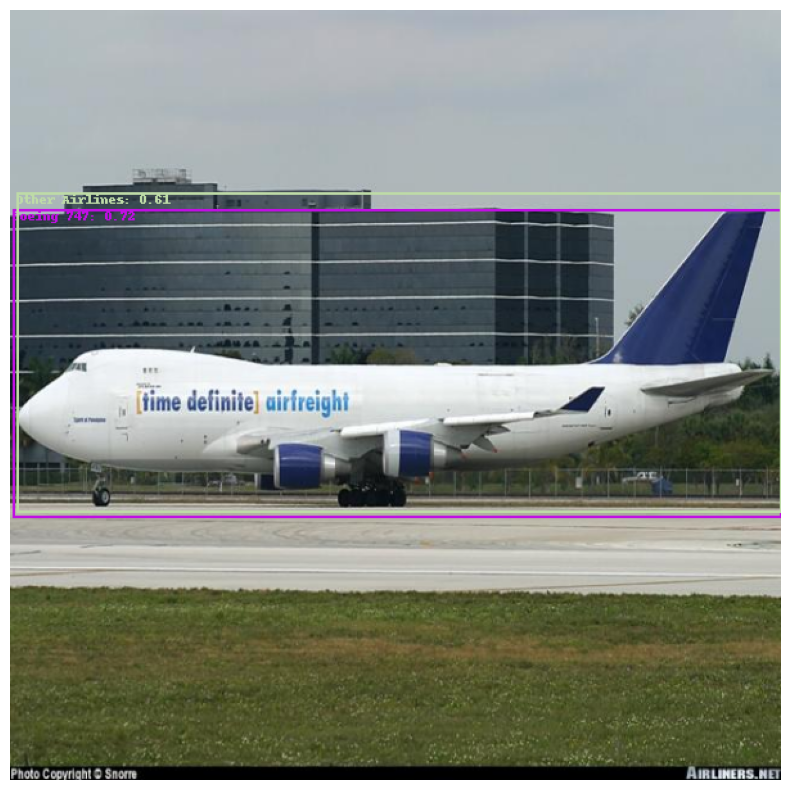

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5]
Northrop Grumman B-2 Spirit: 0.66
Military: 0.43
Northrop Grumman B-2 Spirit: 0.12
Northrop Grumman B-2 Spirit: 0.11
Military: 0.08


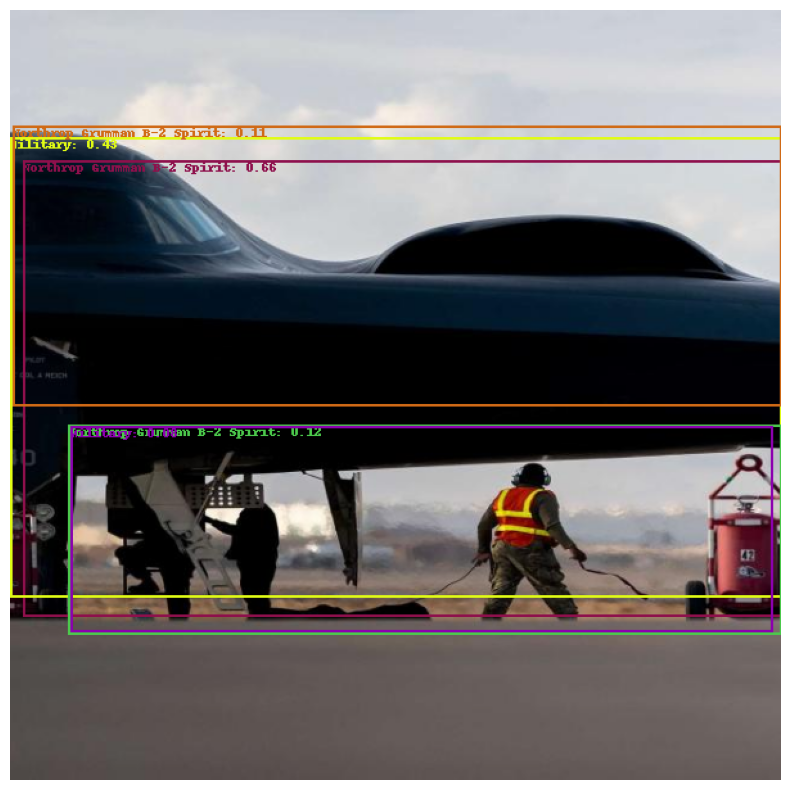

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10]
General Dynamics F-16 Fighting Falcon: 0.73
Military: 0.51
Military: 0.48
General Dynamics F-16 Fighting Falcon: 0.40
Lockheed Martin F-35 Lightning II: 0.15
Northrop Grumman B-2 Spirit: 0.08


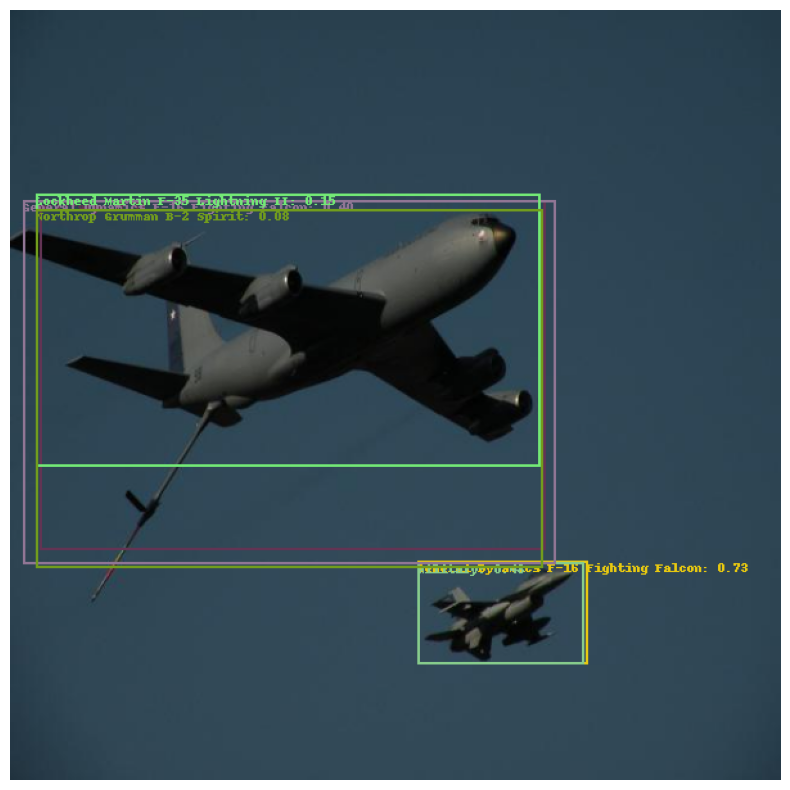

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6]
Other Airlines: 0.82
Boeing 737: 0.44
Airbus A320 Family: 0.08


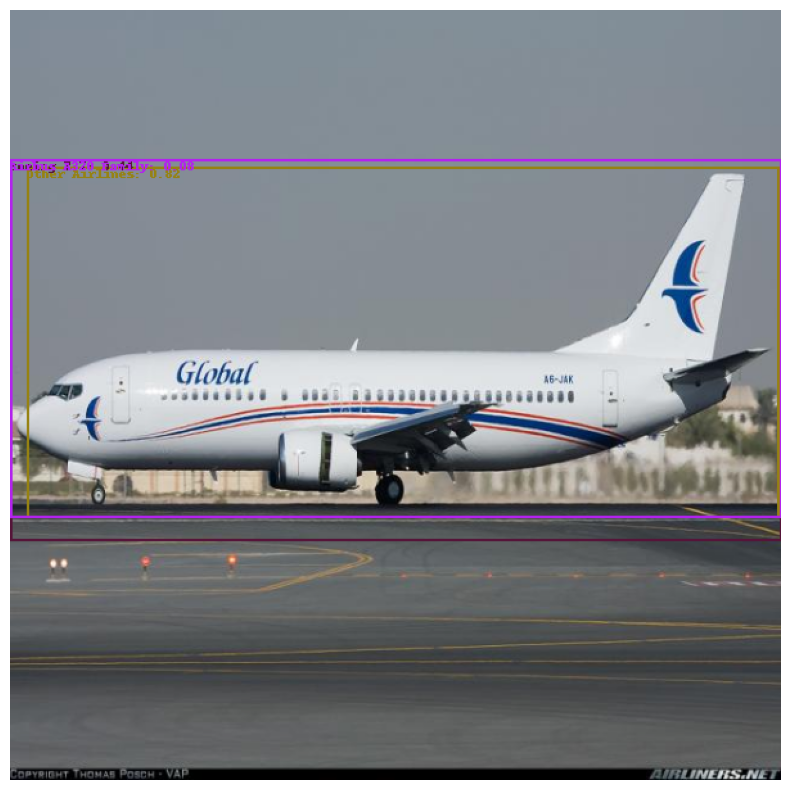

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11]
General Dynamics F-16 Fighting Falcon: 0.69
Military: 0.59
General Dynamics F-16 Fighting Falcon: 0.51
Military: 0.50
Military: 0.49
General Dynamics F-16 Fighting Falcon: 0.44
Lockheed Martin F-35 Lightning II: 0.27
Lockheed Martin F-35 Lightning II: 0.10
Lockheed Martin F-35 Lightning II: 0.07
Military: 0.05


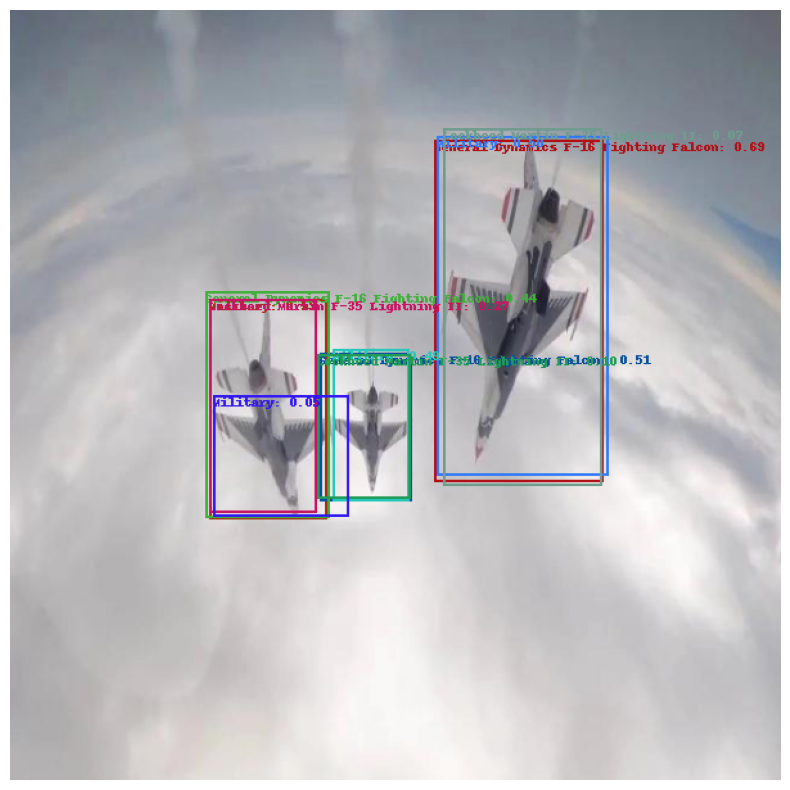

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6]
Lufthansa: 0.95
Airbus A320 Family: 0.13


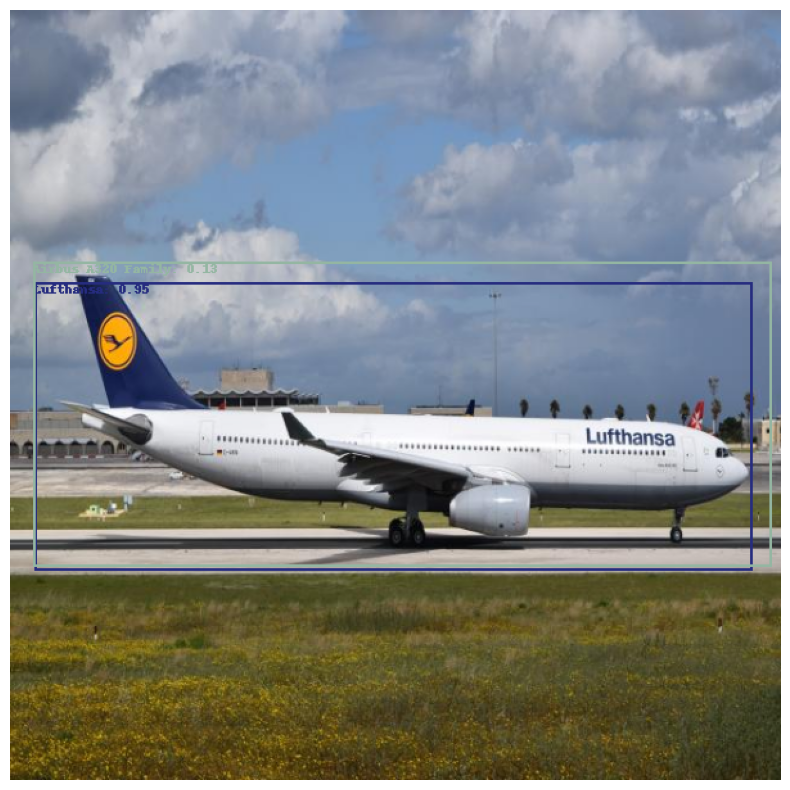

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8]
Lufthansa: 0.65
Airbus A320 Family: 0.54


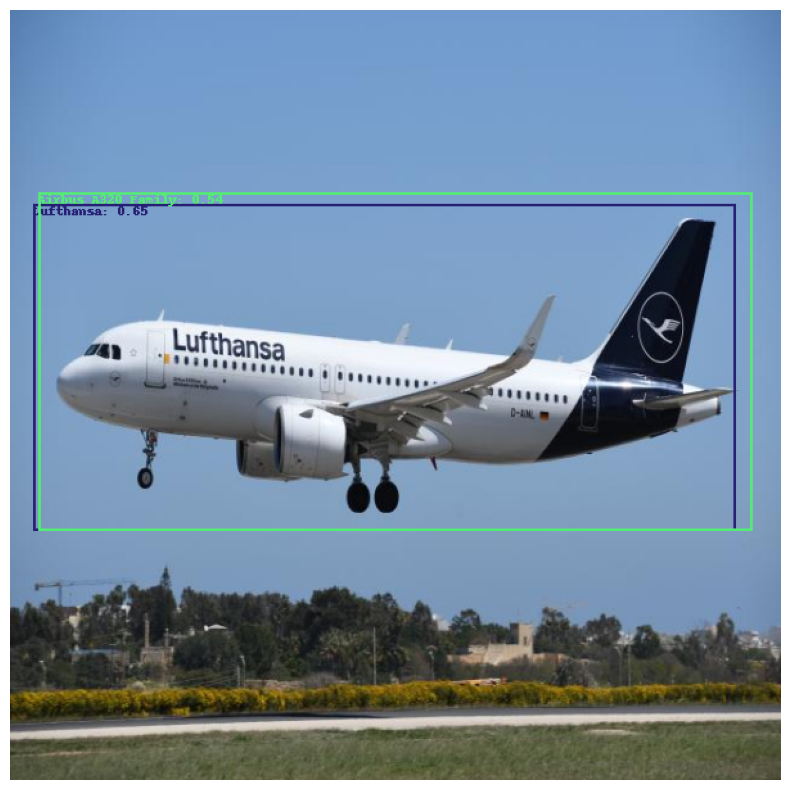

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8]
Military: 0.60
Military: 0.59
Military: 0.52
Lockheed Martin F-35 Lightning II: 0.31
General Dynamics F-16 Fighting Falcon: 0.30
Northrop Grumman B-2 Spirit: 0.24
General Dynamics F-16 Fighting Falcon: 0.22
Lockheed Martin F-35 Lightning II: 0.21
Lockheed Martin F-35 Lightning II: 0.19
Military: 0.09
Military: 0.06


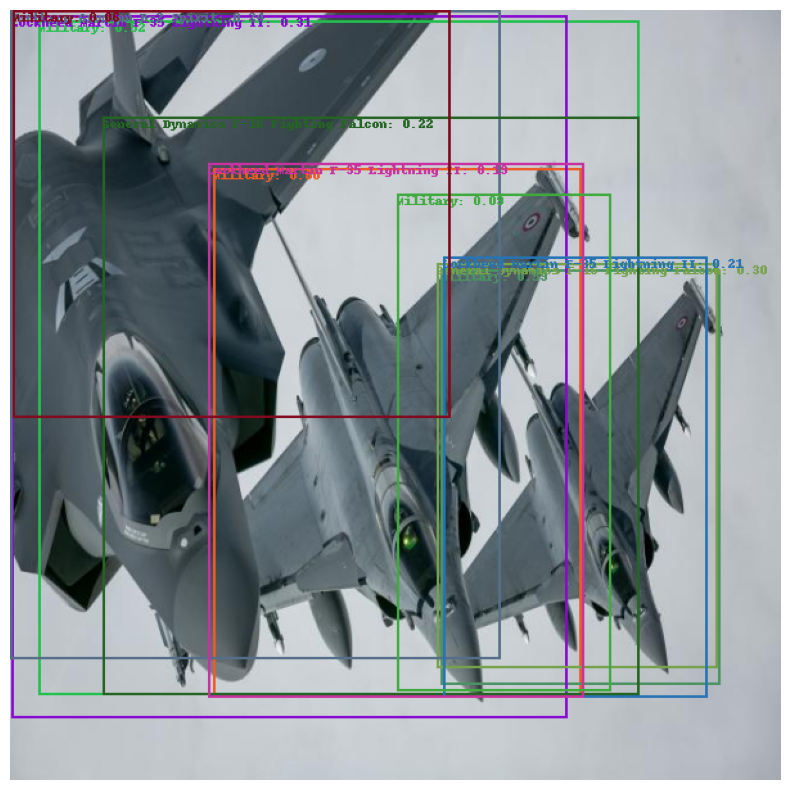

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9]
General Dynamics F-16 Fighting Falcon: 0.43
Military: 0.41
Other Airlines: 0.16
ATR 72: 0.13
A-10 Thunderbolt: 0.09
Northrop Grumman B-2 Spirit: 0.06


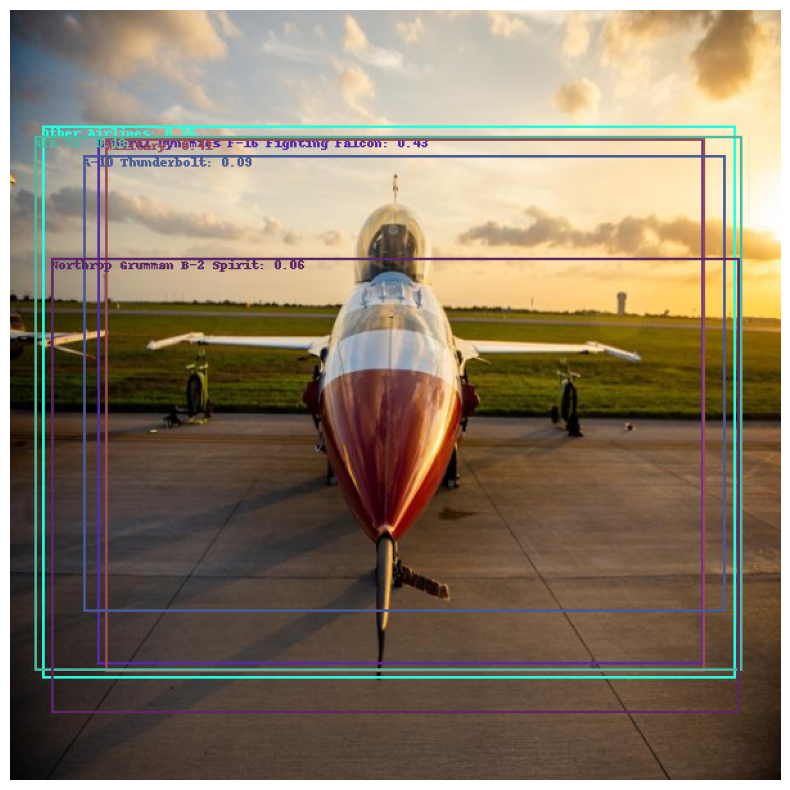

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6]
Boeing 747: 0.61
Other Airlines: 0.60
Lufthansa: 0.09


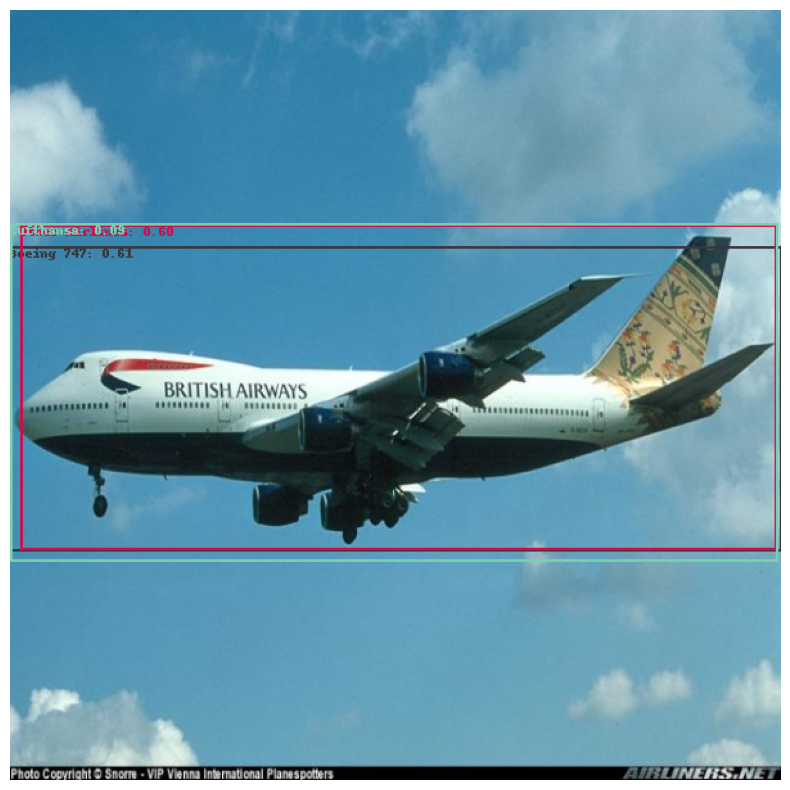

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5]
Airbus A320 Family: 0.73
Other Airlines: 0.42
Boeing 737: 0.13


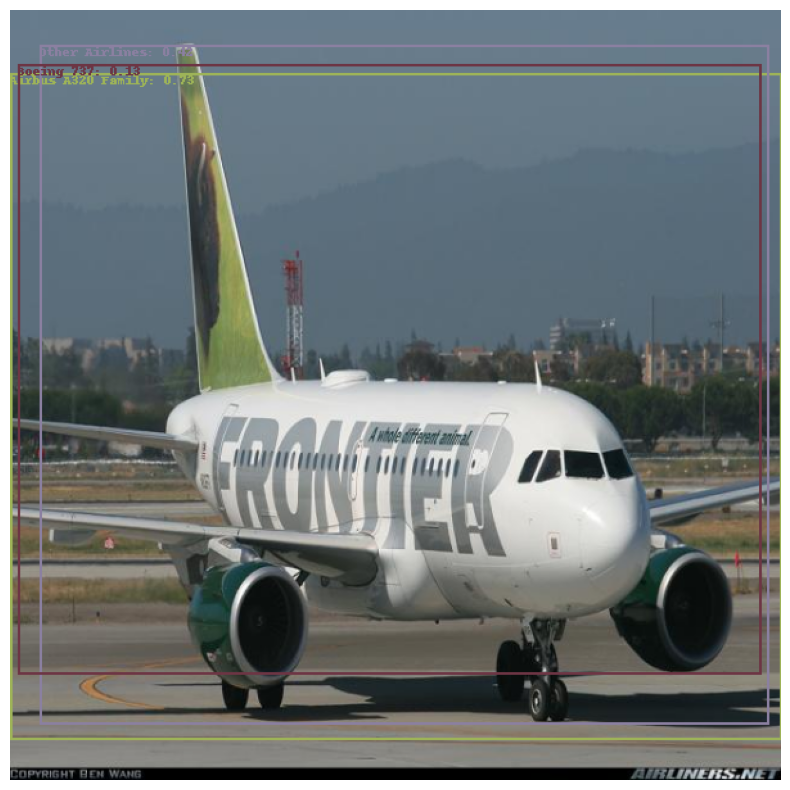

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3]
Northrop Grumman B-2 Spirit: 0.67
Military: 0.55


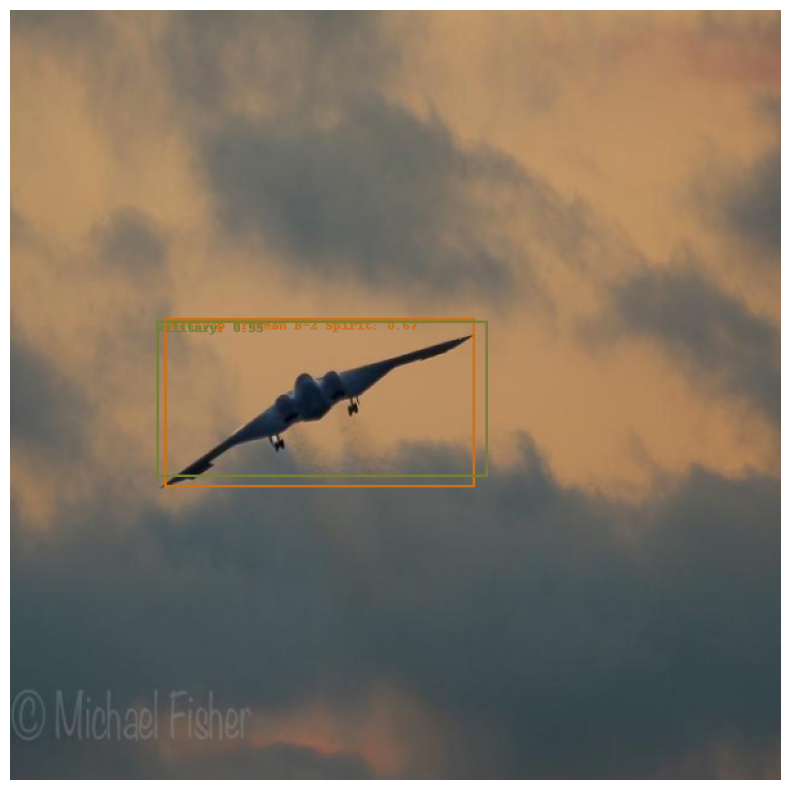

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10]
Other Airlines: 0.71
Boeing 737: 0.51
Airbus A320 Family: 0.05


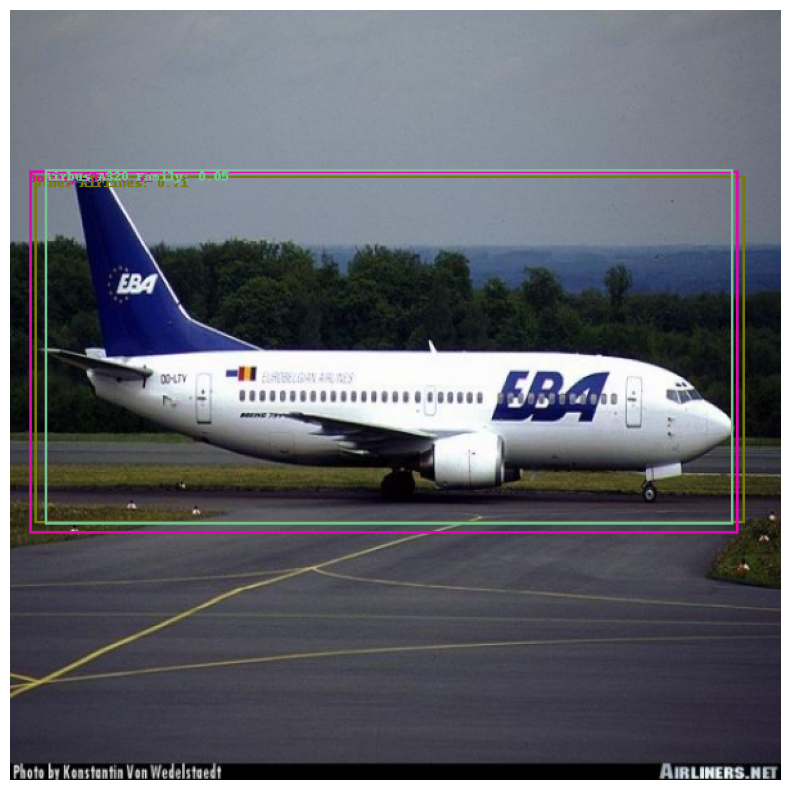

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11]
Airbus A320 Family: 0.61
Lufthansa: 0.45
Other Airlines: 0.23


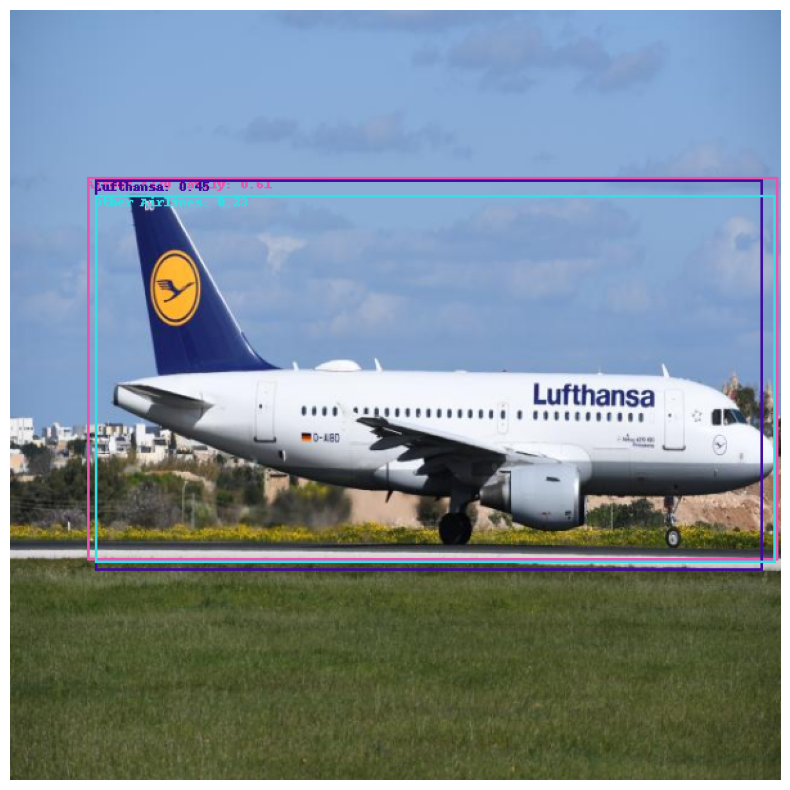

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3]
Airbus A320 Family: 0.52
Lufthansa: 0.51
Other Airlines: 0.43
Boeing 747: 0.06


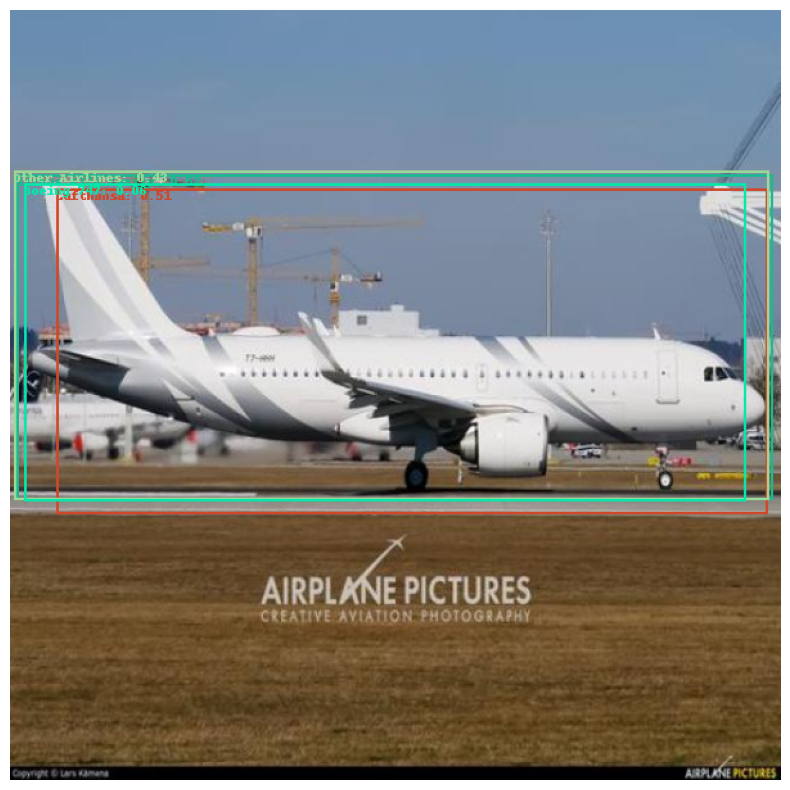

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3]
Northrop Grumman B-2 Spirit: 0.69
Military: 0.39


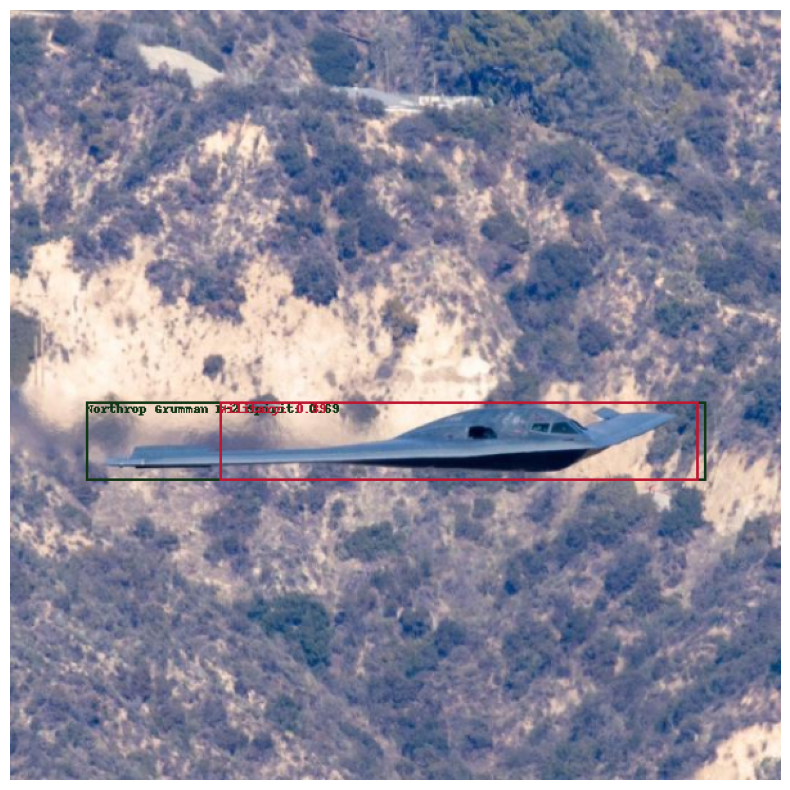

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10]
Military: 0.64
A-10 Thunderbolt: 0.63
A-10 Thunderbolt: 0.58
Military: 0.56
Lockheed Martin F-35 Lightning II: 0.05


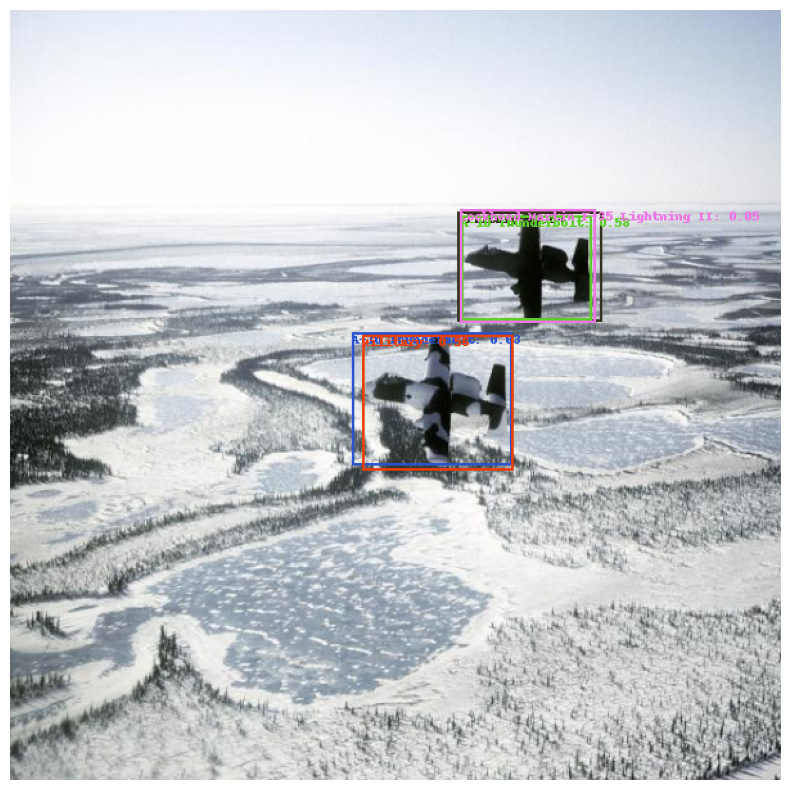

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9]
Lockheed Martin F-35 Lightning II: 0.49
Military: 0.47
General Dynamics F-16 Fighting Falcon: 0.33
Military: 0.31
A-10 Thunderbolt: 0.23
General Dynamics F-16 Fighting Falcon: 0.08
Military: 0.07
Lockheed Martin F-35 Lightning II: 0.06
A-10 Thunderbolt: 0.05


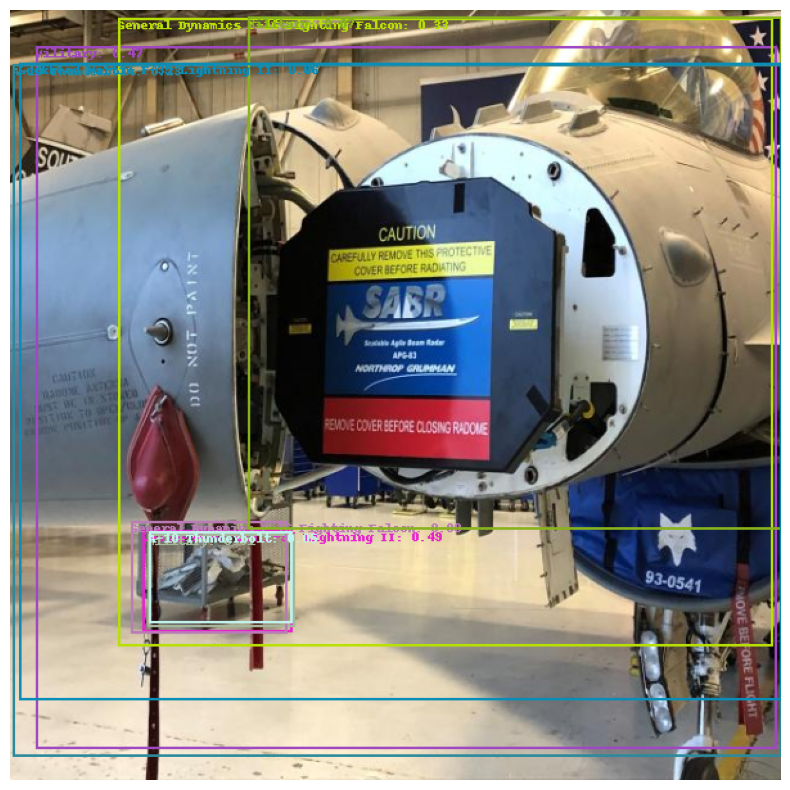

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7]
Northrop Grumman B-2 Spirit: 0.78
Military: 0.42


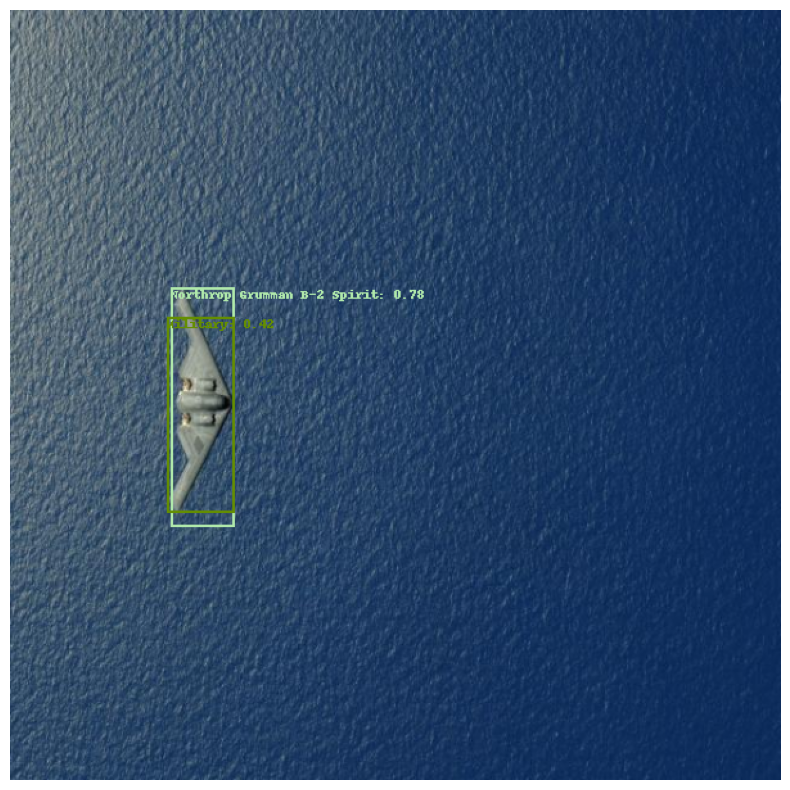

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10]
Military: 0.53
Military: 0.50
General Dynamics F-16 Fighting Falcon: 0.41
A-10 Thunderbolt: 0.37
General Dynamics F-16 Fighting Falcon: 0.19
A-10 Thunderbolt: 0.10


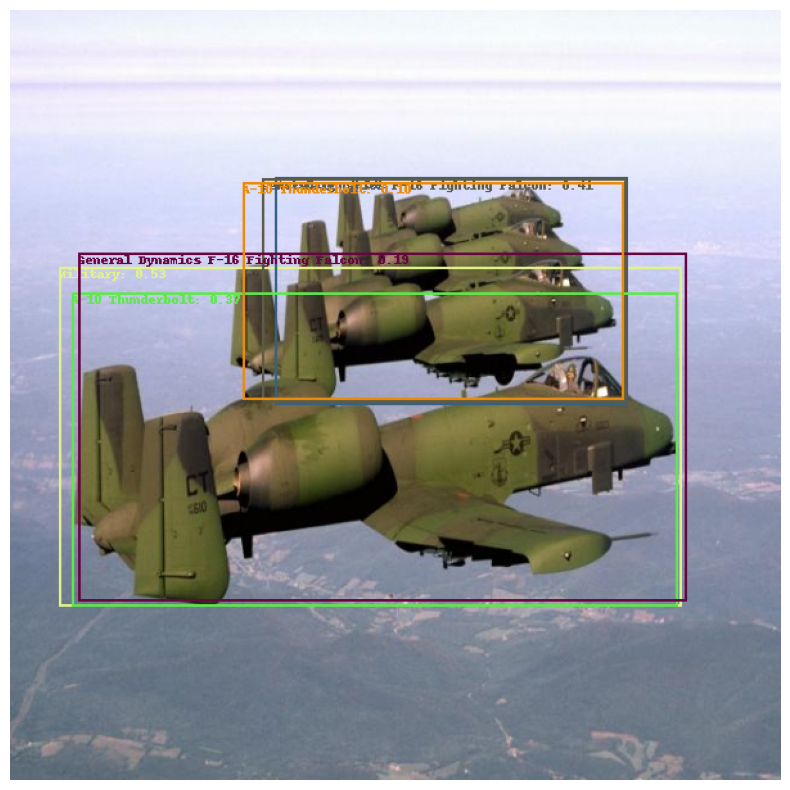

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9]
Lufthansa: 0.82
Airbus A320 Family: 0.40


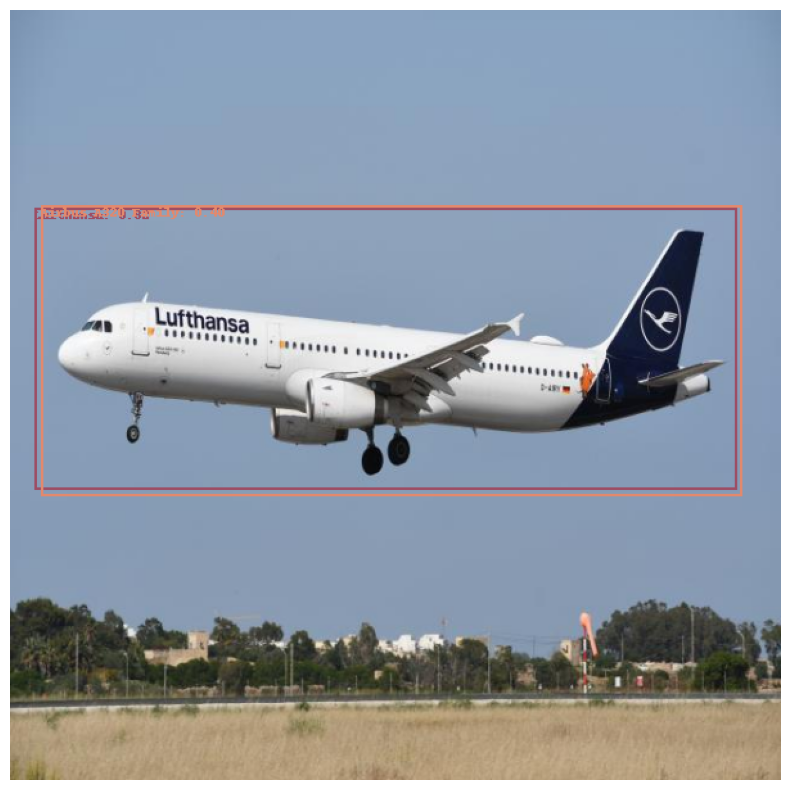

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8]
Northrop Grumman B-2 Spirit: 0.80
Military: 0.26
Military: 0.17
General Dynamics F-16 Fighting Falcon: 0.13
Military: 0.10
Northrop Grumman B-2 Spirit: 0.07
Lockheed Martin F-35 Lightning II: 0.06
Lockheed Martin F-35 Lightning II: 0.05


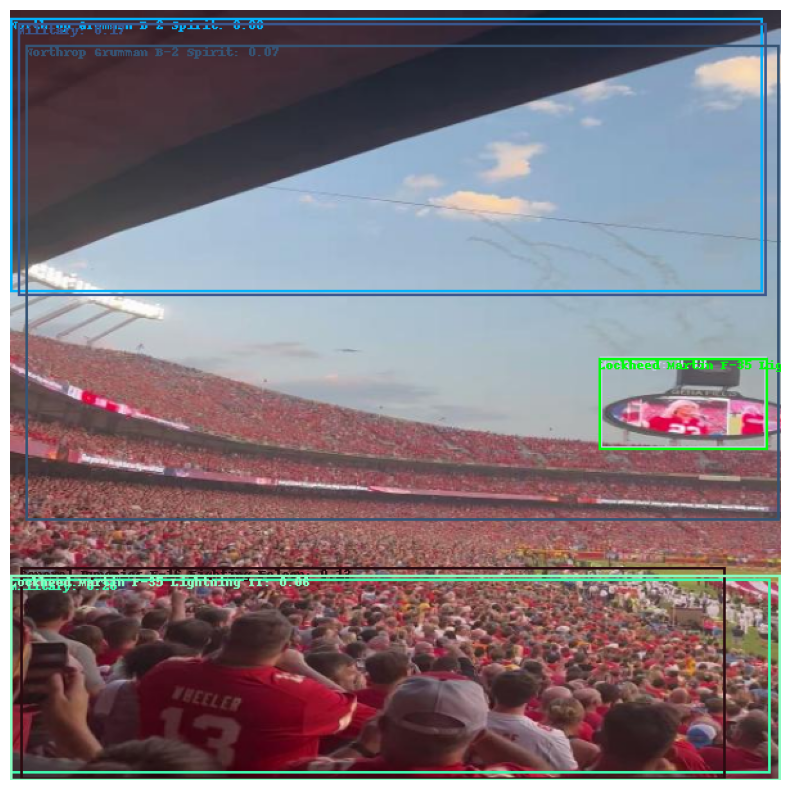

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10]
Boeing 737: 0.70
Ryanair: 0.50
Other Airlines: 0.07


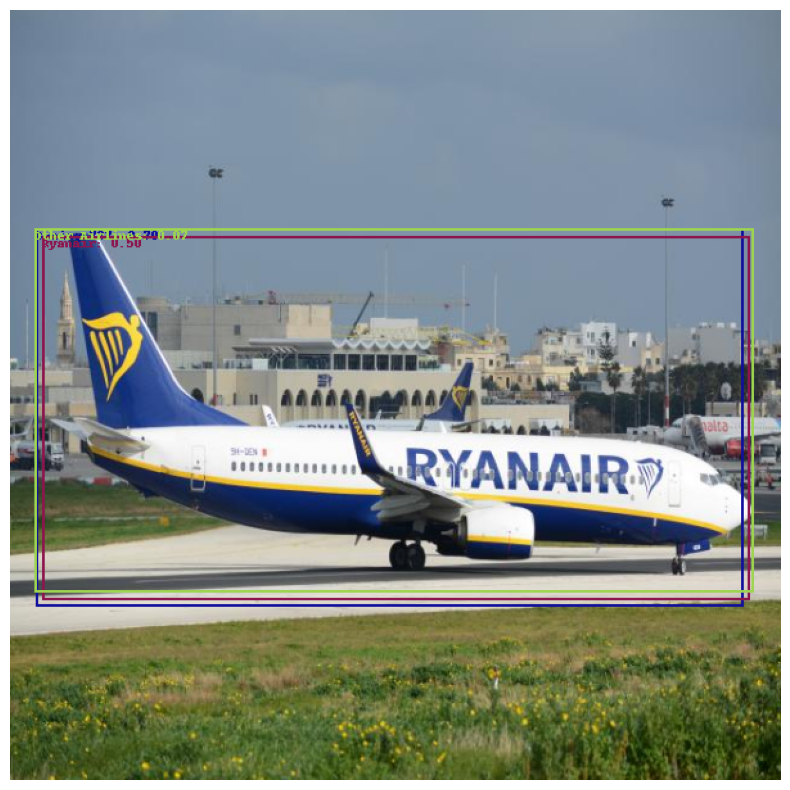

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4]
Boeing 747: 0.75
Other Airlines: 0.66


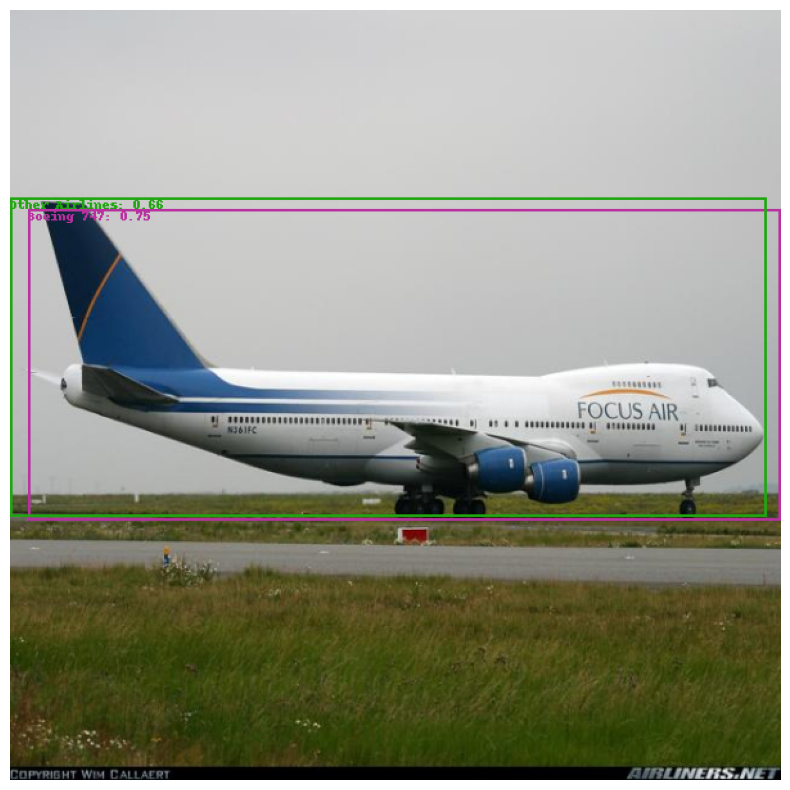

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5]
Other Airlines: 0.69
ATR 72: 0.58


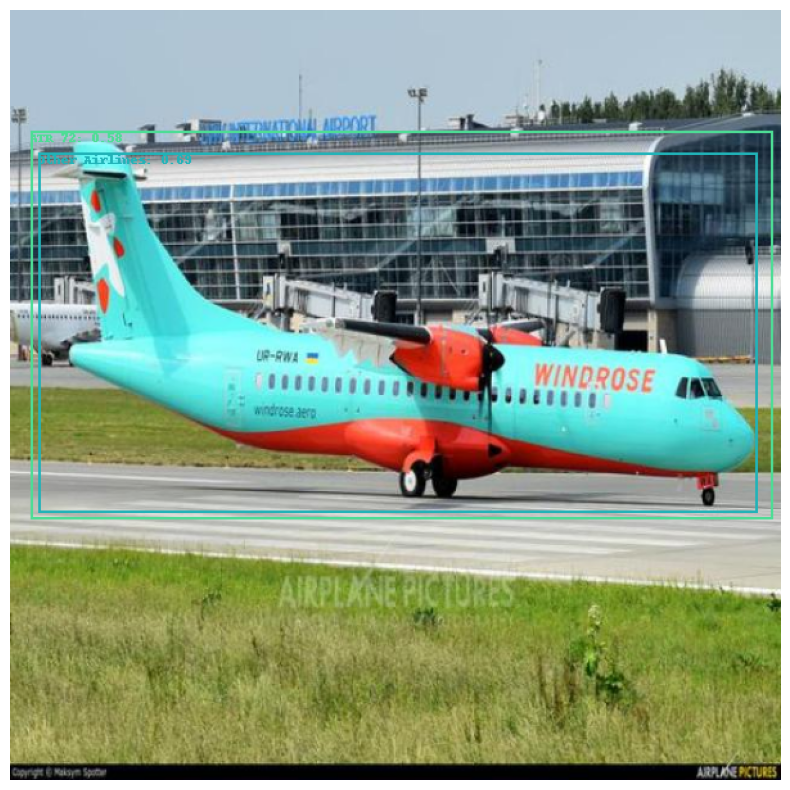

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5, 11]
Other Airlines: 0.69
ATR 72: 0.62


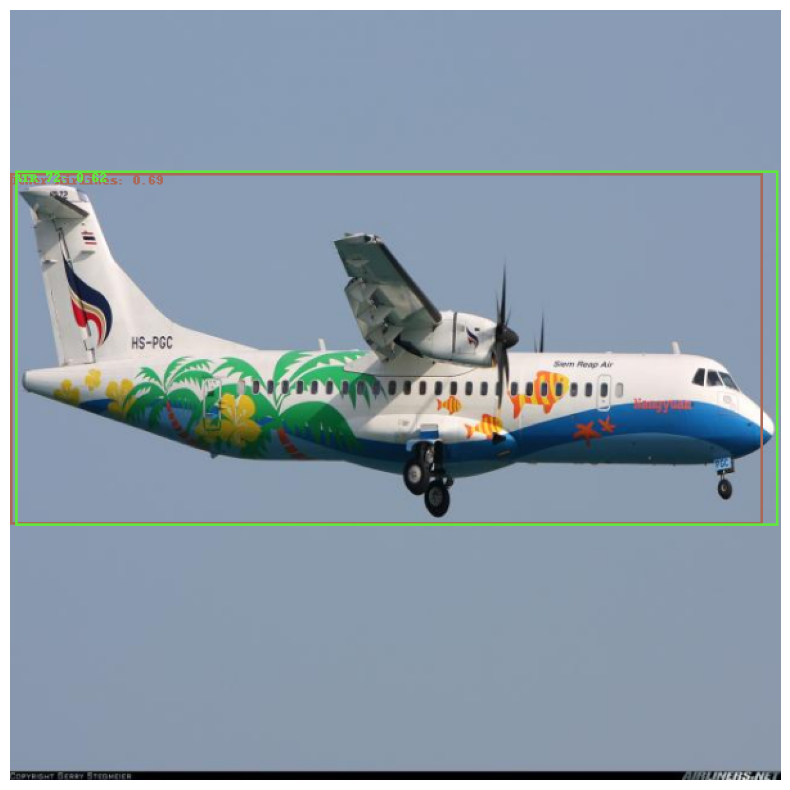

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5, 11, 11]
Northrop Grumman B-2 Spirit: 0.13
Military: 0.12
Military: 0.06


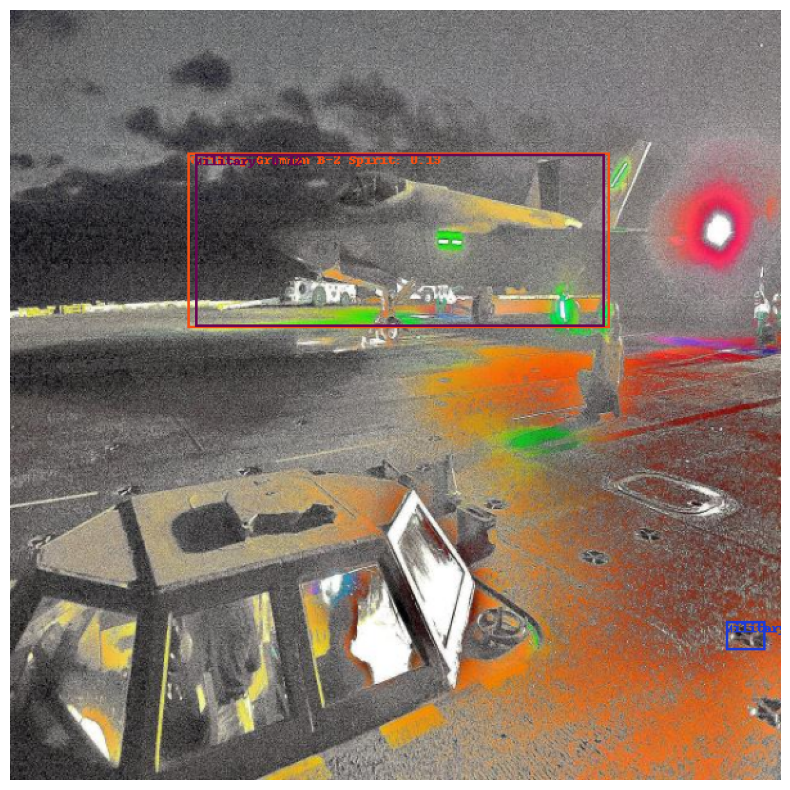

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5, 11, 11, 10]
Airbus A320 Family: 0.61
Other Airlines: 0.49
Lufthansa: 0.12


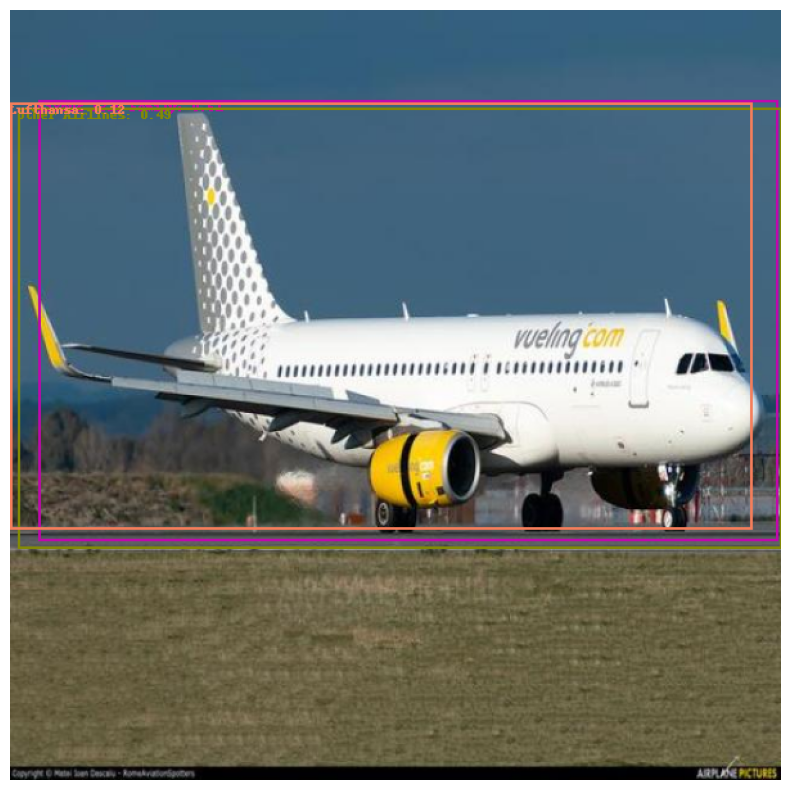

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5, 11, 11, 10, 3]
Other Airlines: 0.85
Airbus A320 Family: 0.48
Other Airlines: 0.46
Boeing 737: 0.30
Airbus A320 Family: 0.27
Lufthansa: 0.19
Boeing 737: 0.09
Military: 0.07


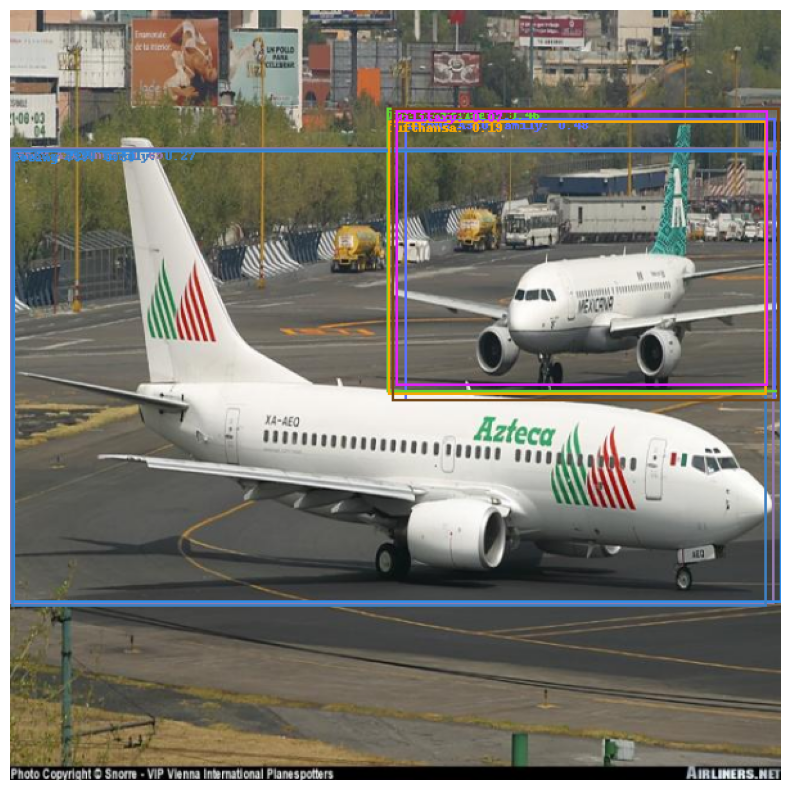

[4, 2, 11, 4, 3, 4, 11, 3, 4, 1, 11, 10, 4, 6, 5, 8, 6, 9, 11, 9, 11, 11, 8, 11, 9, 6, 3, 9, 11, 10, 5, 10, 6, 11, 6, 8, 8, 9, 6, 5, 3, 10, 11, 3, 3, 10, 9, 7, 10, 9, 8, 10, 4, 5, 11, 11, 10, 3, 11]


KeyboardInterrupt: 

In [63]:
import os
import torch
from torchvision.io import read_image
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont
import random

class_names = {
    0: {'id': 0, 'name': 'Aircraft', 'supercategory': 'none'},
    1: {'id': 1, 'name': 'A-10 Thunderbolt', 'supercategory': 'Aircraft'},
    2: {'id': 2, 'name': 'ATR 72', 'supercategory': 'Aircraft'},
    3: {'id': 3, 'name': 'Airbus A320 Family', 'supercategory': 'Aircraft'},
    4: {'id': 4, 'name': 'Boeing 737', 'supercategory': 'Aircraft'},
    5: {'id': 5, 'name': 'Boeing 747', 'supercategory': 'Aircraft'},
    6: {'id': 6, 'name': 'General Dynamics F-16 Fighting Falcon', 'supercategory': 'Aircraft'},
    7: {'id': 7, 'name': 'Lockheed Martin F-35 Lightning II', 'supercategory': 'Aircraft'},
    8: {'id': 8, 'name': 'Lufthansa', 'supercategory': 'Aircraft'},
    9: {'id': 9, 'name': 'Military', 'supercategory': 'Aircraft'},
    10: {'id': 10, 'name': 'Northrop Grumman B-2 Spirit', 'supercategory': 'Aircraft'},
    11: {'id': 11, 'name': 'Other Airlines', 'supercategory': 'Aircraft'},
    12: {'id': 12, 'name': 'Ryanair', 'supercategory': 'Aircraft'}
}

highest_confidence_labels = []

# Define a function to generate random colors
def get_random_color():
    return tuple(random.randint(0, 255) for _ in range(3))

# Iterate over the dataset
for i in range(len(test_dataset)):
    img, _ = test_dataset[i]
    img_int = torch.tensor(img * 255, dtype=torch.uint8)
    with torch.no_grad():
        prediction = model([img.to(device)])
        pred = prediction[0]
    
    sorted_indices = sorted(range(len(pred['scores'])), key=lambda k: pred['scores'][k], reverse=True)
    sorted_labels = [pred['labels'][i] for i in sorted_indices] 
    highest_confidence_label_id = sorted_labels[0].item() if sorted_labels else None
    highest_confidence_labels.append(highest_confidence_label_id)
    
    # Convert img_int to PIL Image
    img_pil = Image.fromarray(img_int.permute(1, 2, 0).cpu().numpy())

    # Draw bounding boxes and confidence scores on the image
    draw = ImageDraw.Draw(img_pil)
    font = ImageFont.load_default()
    

    # Create a color mapping dictionary for each class label
    color_mapping = {}

    for box, label, score in zip(pred['boxes'], pred['labels'], pred['scores']):
        xmin, ymin, xmax, ymax = box.cpu().numpy()
        label_name = class_names[label.item()]['name'] if label.item() in class_names else 'Unknown'
        confidence = f"{label_name}: {score:.2f}"
        print(confidence)

        # Assign a unique color to each class label
        if label not in color_mapping:
            color_mapping[label] = get_random_color()

        color = color_mapping[label]

        # Draw bounding box
        draw.rectangle([xmin, ymin, xmax, ymax], outline=color, width=2)

        # Draw label and confidence score next to the bounding box
        draw.text((xmin, ymin), confidence, fill=color, font=font)

    # Display the image with bounding boxes and confidence scores
    plt.figure(figsize=(14, 10))
    plt.imshow(img_pil)
    plt.axis('off')
    plt.show()
    print(highest_confidence_labels)
    
